In [2]:
from IPython.display import HTML

HTML('''<script>
code_show=true;
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
}
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()">
<input type="submit" value="Click here to toggle on/off the raw code.">
</form>''')

In [3]:
from IPython.display import Image
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as grd
import seaborn as sns
import numpy as np
import sqlite3
import seaborn as sns
import folium
from branca.element import Figure
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import PowerTransformer
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD
from sklearn.cluster import KMeans
from pyclustering.cluster.kmedians import kmedians
from pyclustering.cluster.kmedoids import kmedoids
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.cluster.hierarchy import fcluster, set_link_color_palette
from sklearn.base import clone
from sklearn.metrics import calinski_harabasz_score, silhouette_score
import bisect
import plotly.graph_objects as go
import plotly.io as pio
import plotly.express as px

In [4]:
import warnings
warnings.filterwarnings("ignore")


def showwarning(*args, **kwargs):
    if args[1] is DeprecationWarning:
        return
    warnings._showwarning_orig(*args, **kwargs)
warnings.showwarning = showwarning

# **Travelling in Tokyo: Through the Looking Glass into Tokyo's Airbnb Ecosystem**

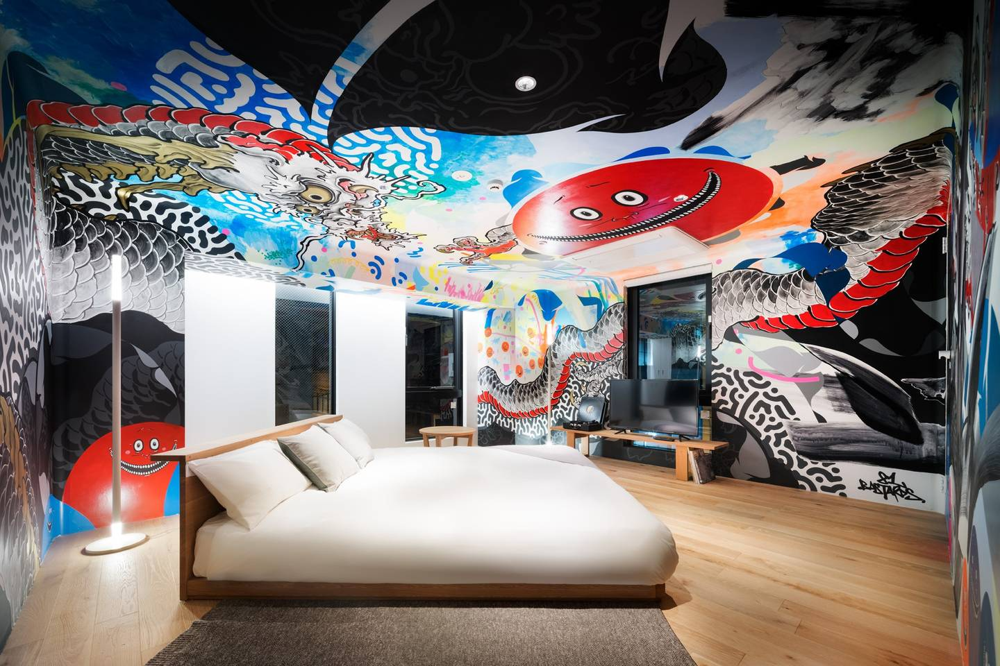

In [5]:
# Insert Image Code Here
Image(filename='airbnb_toyko.jpg')

### **1 Executive Summary**

**Airbnb.com** was a game-changer in the travel accommodation industry, especially for tourism and travel hubs like Tokyo, Japan.  Public datasets have even been made available to allow for a better understanding on how hosts manage their listings and attract guests in key locations, even as they compete with both traditional hotels and the local residential and long-term leasing markets.  This study aimed to use the **Inside Airbnb** public datasets to conduct an exploratory data analysis on Airbnb listings in Tokyo, starting with mapping the geographical dispersion of listings, as well as basic depiction of the distributions of various variables using data visualization.  The features were then grouped sets based on certain themes or dimensions of interest, namely: quality of host service, location and convenience, and finally key listing features and overall experiences. The analysis then focused on applying **dimensionality reduction**, specifically Singular Value Decomposition, to translate the original data to a new coordinate system and aggregate the original features into new vectors (i.e. singular values) that capture the bulk of variance in the dataset. The singular values were then used as basis for **agglomerative clustering**, to identify useful clusters of listings based on the aforementioned dimensions of interest to travelers. It was found that:
- features related to quality of host service resulted in 4 clusters, corresponding to different levels of experience and hosting behavior
- features related to convenience resulted in 3 clusters corresponding to different areas of Tokyo
- key listing features resulted in 13 clusters, primarily corresponding to different combinations of property type and location in key neighborhoods (Taito, Shinjuku, Sumida, Toshima, Shibuya, and Ota)

### **2 Introduction and Motivation for the Study**

Tokyo has long been a popular destination spot for all kinds of travelers. From business travelers needing to meet with  Japanese colleagues, to foodies raring to get a bite of authentic sushi or ramen, to anime and manga fans planning to visit places they've only seen in mass media, to everyday tourists who want to experience Japanese culture firsthand, Tokyo seemingly has something for everyone. Fueled by Tokyo's innate popularity and the Japanese reputation for hospitality and aesthetics, Airbnb's presence in the city has grown to be one of the top in the world, in terms of both occupancy rate and number of listings.

As such, it is interesting to explore the underlying patterns and trends that have emerged in Tokyo's Airbnb ecosystem over the last decade. Browsing Airbnb accommodations on the platform can be overwhelming due to the sheer number of listings and their corresponding features to consider. It would be useful to come up with useful categories, or clusters, of listings based on what a traveler may be looking for.

For travelers who prioritize a seamless interaction with host, can they view listings categorized based on host behavior and quality of service? How about clustering based on geographic location and location and check-in review scores, for travelers who prize convenience most of all? For those interested in the overall accommodation experience, can listings be clustered according to key features and amenities, and overall rating score?

It is hoped that a clustering analysis on a dataset of Airbnb listings will add value to travelers, and make it easier for them to make decisions based on the type of experience they are looking for in the city of Tokyo.

### **3 Problem Statement**

This study will seek to apply basic exploratory data analysis, as well as conduct dimensionality reduction and clustering analysis  on Tokyo's Airbnb listings data to extract key insights and characterizations. It will seek to answer the question:

How can Tokyo Airbnb listings be clustered according to:
- quality of host service?
- convenience and location?
- key listing features and overall experience?


### **4 Methodology**

This study consists of the following steps:

1. Download latest Tokyo Airbnb data which are posted as .csv files on http://insideairbnb.com/.
2. Select key features, partilarly those related to host information, listing information, and review scores.
3. Filter out listings that have null values or have been made unavailable for booking by hosts.
4. Convert categorical data into corresponding label-encoded data and one-hot encoded data.
5. Convert string formatted data like price and number of bathrooms into numerical data.
6. Add derived features such as number of amenities and host age.
7. Save cleaned data into a relational database.
8. Filter out null values and separate data into features related to host service quality, location and convenience, and overall experience.
9. Perform dimensionality reduction using Singular Value Decomposition (SVD) on each data subset and plot the data against the derived singular values.
10. Perform agglomerative clustering based on each data subset, and construct plots to help visualize and analyze the clusters.
11. Interpret and derive insights from each set of clusters.

The scope of this report will not include predictive modelling, regression analysis, nor hypothesis testing, although these techniques may be applied in future related research.


### **5 Data**

#### **5.1 Data Source**

There was one primary dataset used for the study, namely the **Inside Airbnb** (`http://insideairbnb.com/`) listings dataset for Tokyo City, in the Kantō region of Japan.

**Inside Airbnb** is an independent website, unaffiliated with Airbnb or any of its competitors, that aims to make information publicly available about Airbnb listings in major citiies throughout the world.  It allows analysts to filter and explore data on the types of property listed as Airbnb accommodations, their price and availability, and how these are reviewed by guests.  One of the primary motivations behind putting up the website was to let users analyze and understand how hosts are using their real estate assets, from spare beds and rooms to entire homes and apartments to multiple properties, to generate income and potentially compete with the residential housing market via short-term and long-term leases.[1]

All the data on the website is publicly available information, scraped and from `www.airbnb.com`, then verified, cleaned, and aggregated before being posted online.

The  dataset being used from **Inside Airbnb** for this study is the `listings.csv` dataset, updated as of July 20, 2021.  The fields in the dataset that were used in the study are as follows:

<u>Listings Data</u>
- `id` - listing id
- `host_id` - host id
- `host_since` - host start date, convert to host_age in days to distinguish between experienced hosts and new hosts
- `host_response_time` - average amount of time a host responds to inquiries or reservation requests
- `host_response_rate` - percentage of inquiries/reservation requests responded to within 24 hours for the last 30 days
- `host_acceptance_rate` - rate at which a host accepts booking requests.
- `host_is_superhost` - superhost status, a superhost has higher than average host metrics, can be used to check dependency for prices or review scores
- `host_has_profile_pic` - host has profile picture or not, may matter in review scores or prices
- `host_identity_verified` - host's identity is verifed or not, may matter in reviews scores or prices
- `host_has_complete_data` - indicates if the host has valid data for all the previous host features before this.
- `neighbourhood_cleansed` - neighborhood where listing is located, will be converted to one-hot encoded columns, please refer to final listings table
- `latitude` - latitude coordinate of listing
- `longitude` - longitude coordinate of listing
- `room_type` - room type classification of listing, will be converted to one-hot encoded columns, please refer to final listings table
- `accommodates` - number of people that a listing can accomodate
- `bathrooms_text` - number of bathrooms of a listing, will be renamed to bat
- `bedrooms` - number of bedrooms of a listing
- `beds` - number of beds of a listing
- `amenities` - list of amenities included in a listing, will be converted to number of listings instead
- `price` - listed daily price of a listing, in local currency
- `minimum_nights` - minimum nights required to be booked for a listing
- `maximum_nights` - maximum nights that can be booked for a listing
- `availability_365` - availability of the listing 365 days in the future. Lower availability means a listing is booked for most of the year but an availability of 0 means the host has temporarily disabled a listing for booking.
- `number_of_reviews` - total number of reviews for a listing
- `review_scores_rating` - average overall review rating
- `review_scores_accuracy` - average accuracy review rating
- `review_scores_cleanliness` - average cleanliness review rating
- `review_scores_checkin` - average checkin review rating
- `review_scores_communication` - average communication review rating
- `review_scores_location` - average location review rating
- `review_scores_value` - average value review rating
- `review_has_complete_data` - indicates if the listing has valid review ratings for all review fields
- `instant_bookable` - instant booking status of a listing, if false, reservation still needs to be manually approved by the host
- `calculated_host_listings_count` - total listings that a host has on AirBNB
- `reviews_per_month` - average reviews per month

#### **5.2 Data Cleaning and Storage**

The dataset then underwent a number of pre-processing steps prior to being used for analysis:

1. The data was downloaded from the website and filtered for relevant columns as outlined in *Section 5.1*.
2. Filtering was performed on the dataset, based on whether they contained null values, or whether the listing has been made unavailable for booking by their respective hosts. 
3. The `host_since` field, representing the date when a listing host joined the Airbnb platform, was converted to `host_age` to represent instead the number of days since their joining until the date the data was scraped from the website. Host age makes for a more meaningful and interpretable analysis.
4. Ordinal encoding was performed on below ordinal features to convert their values into integer data.  These include:

        Note: Host response time relates to host service quality so ordinal encoding was chosen to measure how responsive a host is.
        
    - Host Response Time
      - Within an hour (1)
      - Within a few hours (2)
      - Within a day (3)
      - Within a few days (4)

    - All features with True/False values, namely: `host_is_superhost`, `host_has_profile_pic`, `host_identity_verified` and `instant_bookable`
      - False (0)
      - True (1)


5. One-hot encoding was performed on categorical data.  These include:
    - Listing neighborhoood (`neighbourhood_cleansed`)
    - Room type (`room_type`)
6. Final data cleaning steps were performed:
    - Prices were converted from $00,000 string format into integer values
    - Features expressed as percentages in string format were stored as decimals, by removing the '%' character and converted to a value between 0 to 1.
    - The types and number of bathrooms were converted from string into numerical format, counting "half-baths" as 0.5 bathrooms.
    - The list of amenities were converted into the number of amenities
    - Columns were added to indicate of a host or listing review has complete information based on the non-empty fields in the dataset (`host_has_complete_data` and `review_has_complete_data`
    - Other features in string format was converted into integer or float format, as applicable.





**Table 1. Count of Null Values per Feature**

In [6]:
# Load the .csv file from InsideAirbnb.com
for_clean = pd.read_csv('/mnt/processed/private/msds2022/slt3a/listings.csv')

# Selected features for listings data
filtered_df = for_clean.iloc[:, [0, 8, 11, 14, 15, 16, 17, 24, 25, 27, 29,
                                 30, 32, 33, 35, 36, 37, 38, 39, 40,
                                 41, 49, 53, 55, 60, 61, 62, 63, 64, 65,
                                 66, 68, 69, 73]]

# Check for null values
filtered_df.isnull().sum()

id                                   0
host_id                              0
host_since                          16
host_response_time                2015
host_response_rate                2015
host_acceptance_rate              1442
host_is_superhost                   16
host_has_profile_pic                16
host_identity_verified              16
neighbourhood_cleansed               0
latitude                             0
longitude                            0
room_type                            0
accommodates                         0
bathrooms_text                       6
bedrooms                           914
beds                                95
amenities                            0
price                                0
minimum_nights                       0
maximum_nights                       0
has_availability                     0
availability_365                     0
number_of_reviews                    0
review_scores_rating              2022
review_scores_accuracy   

In [7]:
# Drop rows with null values
filtered_df = filtered_df.dropna()

# Filter out listings with availability_365 = 0
# These are listings that are made temporarily unavailable by hosts
filtered_df = filtered_df[filtered_df['availability_365'] > 0]

# Filter out listings that have minimum nights requirements of more than a year
# (to get rid of outlier listings with 999 minimum nights)
filtered_df = filtered_df[filtered_df['minimum_nights'] < 365]

In [8]:
# Create function to convert host_since date to host_age. Ignore blank values.
def get_age(x):
    """Compute number of days a host has been on the AirBNB platform."""
    age = ''
    if x != '':
        scrape_date = pd.to_datetime(for_clean['last_scraped'].unique()[0])
        start_date = pd.to_datetime(x)
        age = (scrape_date - start_date).days
    return age

# Convert host_since to host_age to make it a more meaningful and interpretable
# feature for analysis    
filtered_df['host_since'] = (filtered_df['host_since'].
                             apply(lambda x: get_age(x)).copy())
filtered_df = filtered_df.rename(columns={'host_since': 'host_age'})

In [9]:
# Ordinal encoding: Host Response Time
# We will use ordinal encoding to represent how fast a host responds to
# inquiries. The lower the number, the faster the response time. 
host_response_dict = {'within an hour': 1,
                      'within a few hours': 2,
                      'within a day': 3,
                      'a few days or more': 4,
                      '': ''}
filtered_df['host_response_time'] = (filtered_df['host_response_time']
                                     .map(host_response_dict))

In [10]:
# Ordinal encoding: True/False Features
bool_dict = {'f': 0,
             't': 1,
             '': ''}
filtered_df['host_is_superhost'] = (filtered_df['host_is_superhost']
                                    .map(bool_dict))
filtered_df['host_has_profile_pic'] = (filtered_df['host_has_profile_pic']
                                       .map(bool_dict))
filtered_df['host_identity_verified'] = (filtered_df['host_identity_verified']
                                         .map(bool_dict))
filtered_df['instant_bookable'] = (filtered_df['instant_bookable']
                                   .map(bool_dict))

In [11]:
# One-hot encode neighborhood and insert into the filtered dataframe
neighborhood_ohe = pd.get_dummies(filtered_df['neighbourhood_cleansed'])
neighborhood_ohe.columns = [column.replace(' ', '_') for
                            column in neighborhood_ohe.columns]
filtered_df = pd.concat([filtered_df.iloc[:, :9], neighborhood_ohe,
                         filtered_df.iloc[:, 10:]], axis=1)

In [12]:
# One-hot encode room type and insert into the filtered dataframe
room_type_ohe = pd.get_dummies(filtered_df['room_type'])
room_type_ohe.columns = [column.replace(' ', '_') for
                         column in room_type_ohe.columns]
filtered_df = pd.concat([filtered_df.iloc[:, :57], room_type_ohe,
                         filtered_df.iloc[:, 58:]], axis=1)

In [13]:
# Convert prices into integer values
filtered_df['price'] = (filtered_df['price'].str.replace('$', '', regex=True).
                        str.replace(',', '', regex=True).
                        astype(float).astype(int))

In [14]:
# Convert percentages to decimals
def rate_cleaner(x):
    """Convert percentages to decimals."""
    output = ''
    if x != 'N/A' and x != '':
        output = int(x.split('%')[0])/100
    return output

filtered_df['host_response_rate'] = (filtered_df['host_response_rate'].
                                     apply(lambda x: rate_cleaner(x)))
filtered_df['host_acceptance_rate'] = (filtered_df['host_acceptance_rate'].
                                       apply(lambda x: rate_cleaner(x)))

In [15]:
# Convert bathroom lists to numerical values
def bathnum_cleaner(x):
    """Count the number of bathrooms, counting half-baths as 0.5."""
    output = ''
    half_bath_list = ["Half-bath", "Private half-bath", "Shared half-bath"]
    if x != '':
        if x in half_bath_list:
            output = 0.5
        else:
            output = float(x.split(' ')[0])
    return output

filtered_df['bathrooms_text'] = (filtered_df['bathrooms_text'].
                                 apply(lambda x: bathnum_cleaner(x)))
filtered_df = filtered_df.rename(columns={'bathrooms_text': 'bathrooms_num'})

In [16]:
# Convert amenities lists to number of bathrooms
filtered_df['amenities'] = (filtered_df['amenities'].
                            apply(lambda x: len(x.split(','))))
filtered_df = filtered_df.rename(columns={'amenities': 'amenities_num'})

In [17]:
# Convert certain columns from text to numerical format
filtered_df.iloc[:, 2:9] = filtered_df.iloc[:, 2:9].replace('', np.nan)
filtered_df.iloc[:, -22:] = filtered_df.iloc[:, -22:].replace('', np.nan)
filtered_df.iloc[:, 2:4] = filtered_df.iloc[:, 2:4].astype('Int64')
filtered_df.iloc[:, 4:6] = filtered_df.iloc[:, 4:6].astype(float)
filtered_df.iloc[:, 6:9] = filtered_df.iloc[:, 6:9].astype('Int64')
filtered_df.iloc[:, -22:-19] = filtered_df.iloc[:, -22:-19].astype(float)
filtered_df.iloc[:, -12:-5] = filtered_df.iloc[:, -12:-5].astype(float)
filtered_df.iloc[:, -3] = filtered_df.iloc[:, -3].astype(float)

Having cleansed and pre-processed the dataset, the next step was to save the dataset as an SQLite3 database file, to facilitate storage and retrieval.

In [18]:
# Store data in SQLite3 database
conn = sqlite3.connect('airbnb_data.db')
filtered_df.to_sql('listings_data', conn, if_exists='replace', index=False)

**Table 2. SQLite3 Database Schema**

In [19]:
cursor = conn.cursor()
cursor.execute("SELECT name FROM sqlite_master WHERE type='table';")
sql_tables = [table[0] for table in cursor.fetchall()]
for table_name in sql_tables:
    print('\nTable Name: ' + table_name)
    display(pd.DataFrame(cursor.execute(f"PRAGMA table_info('{table_name}')").
                         fetchall(), columns=['row', 'field name', 'type',
                                              'not nullable', 'default',
                                              'primary key']).
            set_index('row').reset_index(drop=True))
conn.close()


Table Name: listings_data


,field name,type,not nullable,default,primary key
0,id,INTEGER,0,None,0
1,host_id,INTEGER,0,None,0
2,host_age,INTEGER,0,None,0
3,host_response_time,INTEGER,0,None,0
4,host_response_rate,REAL,0,None,0
...,...,...,...,...,...
77,review_scores_location,REAL,0,None,0
78,review_scores_value,REAL,0,None,0
79,instant_bookable,REAL,0,None,0
80,calculated_host_listings_count,INTEGER,0,None,0


### **6 Descriptive Analytics**

#### **6.1 Initial Data Exploration**

For the initial data exploration, the data was retrieved from the SQLite3 database and various sets of features were graphed using the appropriate plots to examine their distributions.

In [20]:
# Load data from SQLite3 database

conn = sqlite3.connect('airbnb_data.db')
sql_query = """SELECT * from listings_data"""
all_df = pd.read_sql(sql_query, conn)
conn.close()
filtered_df = all_df[all_df != ''].dropna()

To start with, for latitude and longitude data, a map was used to as a visualization of the geographic distribution  of the various Airbnb listings across Tokyo.  Color-coding was used to differentiate property types: blue for entire homes, orange for hotel rooms, green for private rooms within a home, and red for shared rooms.  A darker shade was also used to represent listings hosted by Superhosts, as opposed to regular hosts without the Superhost distinction.  Popup-labels were also added to allow viewing of certain listing features, such as the listing `id` and the `review score` by hovering a mouse pointer over a listing marker when viewing this report in HTML format.

In [21]:
def add_categorical_legend(folium_map, title, colors, labels):
    """Add a legend to a Folium map."""
    if len(colors) != len(labels):
        raise ValueError("colors and labels must have the same length.")
    color_by_label = dict(zip(labels, colors))
    legend_categories = ""
    for label, color in color_by_label.items():
        legend_categories += (f"<li><span style='background:{color}'>" +
                              f"</span>{label}</li>")
    legend_html = f"""
    <div id='maplegend' class='maplegend'>
      <div class='legend-title'>{title}</div>
      <div class='legend-scale'>
        <ul class='legend-labels'>
        {legend_categories}
        </ul>
      </div>
    </div>
    """
    script = f"""
        <script type="text/javascript">
        var oneTimeExecution = (function() {{
                    var executed = false;
                    return function() {{
                        if (!executed) {{
                             var checkExist = setInterval(function() {{
                                       if ((document.getElementsByClassName
                                       ('leaflet-top leaflet-right').length) ||
                                       (!executed)) {{
                                          document.getElementsByClassName
                                          ('leaflet-top leaflet-right')[0]
                                          .style.display = "flex"
                                          document.getElementsByClassName
                                          ('leaflet-top leaflet-right')[0]
                                          .style.flexDirection = "column"
                                          document.getElementsByClassName
                                          ('leaflet-top leaflet-right')[0]
                                          .innerHTML += `{legend_html}`;
                                          clearInterval(checkExist);
                                          executed = true;
                                       }}
                                    }}, 100);
                        }}
                    }};
                }})();
        oneTimeExecution()
        </script>
      """
    css = """
    <style type='text/css'>
      .maplegend {
        z-index:9999;
        float:right;
        background-color: rgba(255, 255, 255, 1);
        border-radius: 5px;
        border: 2px solid #bbb;
        padding: 10px;
        font-size:12px;
        positon: relative;
      }
      .maplegend .legend-title {
        text-align: left;
        margin-bottom: 5px;
        font-weight: bold;
        font-size: 90%;
        }
      .maplegend .legend-scale ul {
        margin: 0;
        margin-bottom: 5px;
        padding: 0;
        float: left;
        list-style: none;
        }
      .maplegend .legend-scale ul li {
        font-size: 80%;
        list-style: none;
        margin-left: 0;
        line-height: 18px;
        margin-bottom: 2px;
        }
      .maplegend ul.legend-labels li span {
        display: block;
        float: left;
        height: 16px;
        width: 30px;
        margin-right: 5px;
        margin-left: 0;
        border: 0px solid #ccc;
        }
      .maplegend .legend-source {
        font-size: 80%;
        color: #777;
        clear: both;
        }
      .maplegend a {
        color: #777;
        }
    </style>
    """
    folium_map.get_root().header.add_child(folium.Element(script + css))
    return folium_map

**Figure 1. Geographical distribution of Airbnb listings in Tokyo, Japan**

In [22]:
# Alternative code to randomly sample listings, to speed up map generation
# and avoid memory issues:
sample_df = filtered_df.sample(frac=0.5, random_state=1)
# sample_df = filtered_df.copy()

lat = sample_df['latitude']
lon = sample_df['longitude']
ratings = sample_df['review_scores_rating']
list_id = sample_df['id']
host_id = sample_df['host_id']
superhost = sample_df['host_is_superhost']
property_type = (sample_df['Entire_home/apt']*1 +
                 sample_df['Hotel_room']*2 +
                 sample_df['Private_room']*3 +
                 sample_df['Shared_room']*4)

host_type = {0: 'No', 1: 'Yes'}
superhost_opac = {0: 0.5, 1: 0.9}
property_color = {1: 'blue', 2: 'orange', 3: 'green', 4: 'red'}
room_type = {1: 'Entire home', 2: 'Hotel room',
             3: 'Private room', 4: 'Shared room'}

map = folium.Map(location=[np.mean(lat), np.mean(lon)], zoom_start=11)
fg = folium.FeatureGroup(name="Airbnbs")
for lat, lon, rating, list_id, host_id, superhost, prop_type in\
        zip(lat, lon, ratings, list_id, host_id, superhost, property_type):
    fg.add_child(folium.Circle(location=[lat, lon],
                               radius=50, weight=3,
                               opacity=superhost_opac[superhost],
                               color=property_color[prop_type], fill=True,
                               fill_color=property_color[prop_type],
                               fill_opacity=superhost_opac[superhost],
                               popup=(f"Listing id: {list_id}\n"
                                      f"Host id: {host_id}\n"
                                      f"Rating: {rating}\n"
                                      f"Superhost: {host_type[superhost]}\n"
                                      f"Property Type: {room_type[prop_type]}")
                               ))
map.add_child(fg)
map_legend = add_categorical_legend(map, 'Legend',
                                    colors=['blue', 'orange',
                                            'green', 'red'],
                                    labels=['Entire home', 'Hotel room',
                                            'Private room', 'Shared room'])
map_legend

Not surprisingly, it can be seen that the majority of Airbnb listings are clustered in certain districts of Central Tokyo, with fewer rooms for rent towards the outskirts.  Also most listings are entire homes, showing that hosts would mainly invest or dedicate entire properties for rental, in contrast to the earliest days of Airbnb when it was simply envisioned as a means for hosts to make spare cash by renting out air mattresses. [2]

The distribution of host characteristics were plotted as well, using histograms or kernel density estimate (KDE) plots in cases when the data distributions are too narrow or skewed for these to appear clearly on a histogram.

**Figure 2.  Distribution Plots for Host-related features of Airbnb Listings in Tokyo, Japan**

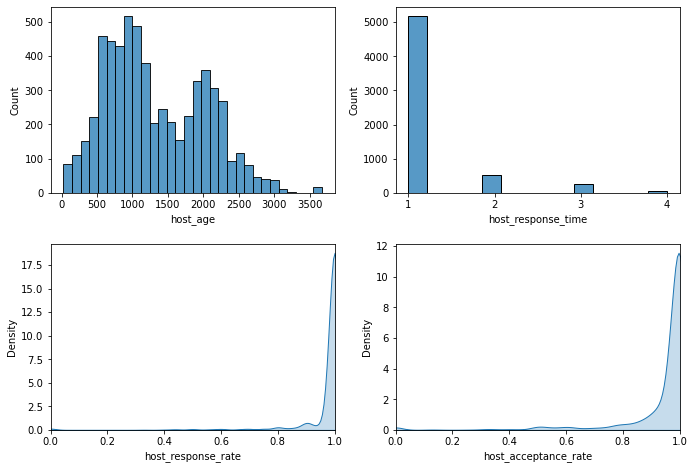

In [23]:
df_host_info = filtered_df.iloc[:, 2:9]

fig, ax = plt.subplots(2, 2, figsize=(10, 7))
fig.tight_layout(pad=3)

sns.histplot(df_host_info['host_age'], ax=ax[0, 0])
sns.histplot(df_host_info['host_response_time'], ax=ax[0, 1])
ax[0, 1].set_xticks(range(1, 5))
sns.kdeplot(df_host_info['host_response_rate'], ax=ax[1, 0], fill=True)
ax[1, 0].set_xlim(0, 1)
sns.kdeplot(df_host_info['host_acceptance_rate'], ax=ax[1, 1], fill=True)
ax[1, 1].set_xlim(0, 1)
plt.show()

The plots show that the vast majority of hosts respond to booking inquiries, and rather quickly at that.  The acceptance rates of most hosts are also quite high, which means hosts are not overly selective in allowing guests into their properties.  As of the length of time that hosts have been on the platform, there is no particular behavior to the distribution other than being roughly bimodal over a time range of roughly 10 years.

In addition to host duration on the platform and behavior, there are also a set of binary host-related features, such as verification-related data on whether a host has uploaded their profile picture, or been verified by the Airbnb system.

There is also the Superhost status, which is a badge given by Airbnb to hosts based on their ability to provide consistent and exemplary experiences for their guests.  The Superhost status is given to hosts who have met the following criteria [3] over the past four quarters, and is evaluated quarterly:

- *Completed at least 10 trips OR completed 3 reservations that total at least 100 nights*
- *Maintained a 90% response rate or higher*
- *Maintained a 1% cancellation rate (1 cancellation per 100 reservations) or lower, with exceptions made for extenuating circumstances*
- *Maintained a 4.8 overall rating (this rating looks at the past 365 days of reviews, based on the date the guest left a review, not the date the guest checked out)*

**Figure 3. Distributions of Superhost and Verification Status of Hosts for Airbnb Listings in Tokyo, Japan**

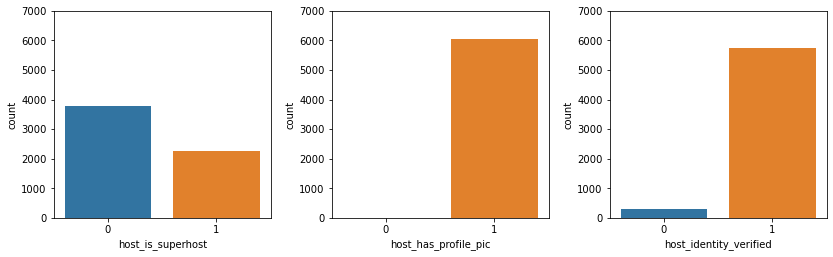

In [24]:
fig, ax = plt.subplots(1, 3, figsize=(12, 4))
plt.tight_layout(pad=3)

sns.countplot(x=df_host_info['host_is_superhost'], ax=ax[0])
sns.countplot(x=df_host_info['host_has_profile_pic'], ax=ax[1])
sns.countplot(x=df_host_info['host_identity_verified'], ax=ax[2])
ax[0].set_ylim(0, 7000)
ax[1].set_ylim(0, 7000)
ax[2].set_ylim(0, 7000)
plt.show()

The bar plots show that of the approximately 6400 Airbnb listings under consideration, the hosts for roughly 2400 of the listings have achieved Superhost status.  Also, virtually all hosts have updated their profile pictures and the vast majority have had their identity verified on the platform, contributing to to the safety of both hosts and guests.

Another set of features, aside from location data like neighborhood, latitude, or longitude, are those related to the listings themselves.  While not exhaustive, key features include:
- the type of property listed
- the number of guests the listing can accommodate
- price
- availability over the next 365 days
- whether the unit allows Instant Booking (booking by a guest without manual verification and approval by the host)
- the total number of beds, bedrooms, bathrooms, and amenities in the listing
- the historical average number of reviews per month
- the average minimum number of nights required for a listing to be booked (this may vary over time depending on the calendar settings defined by the host)

**Figure 4. Distributions of Booking and Listing-related Features for Airbnb Listings in Tokyo, Japan**

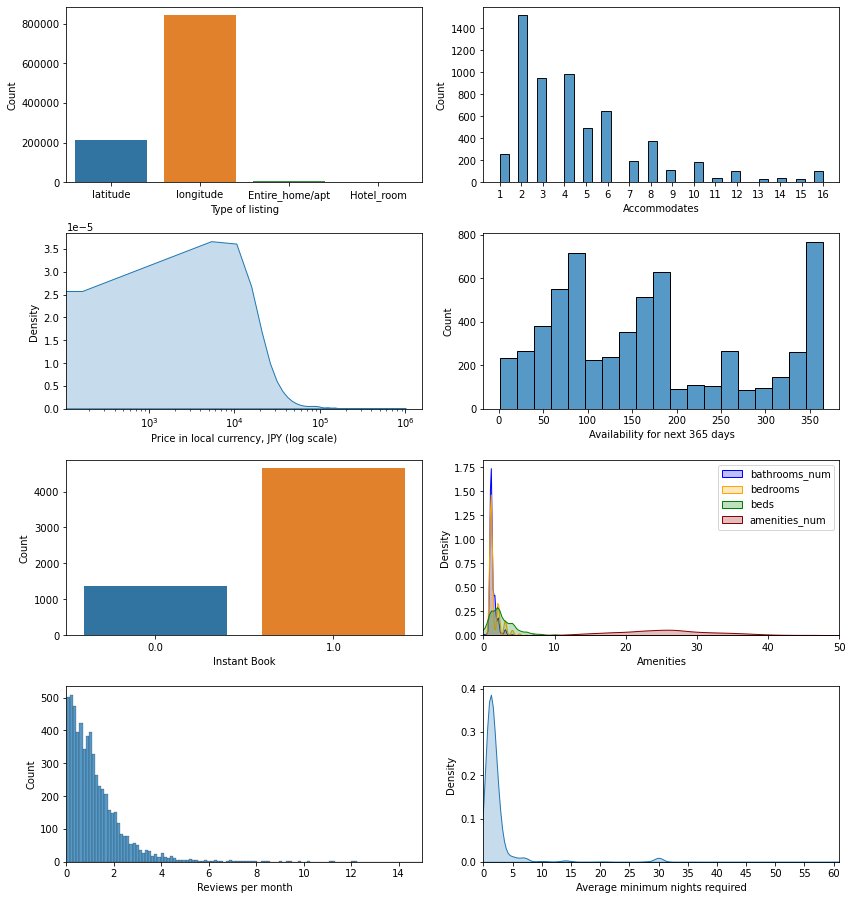

In [25]:
df_listing_info = pd.concat([filtered_df.iloc[:, -27:-10],
                             filtered_df.iloc[:, -3:]], axis=1)

fig, ax = plt.subplots(4, 2, figsize=(12, 13))
fig.tight_layout(pad=3)

# Types of accommodations
sns.barplot(x=df_listing_info.columns[:4],
            y=df_listing_info.iloc[:, 0:4].sum(axis=0), ax=ax[0, 0])
ax[0, 0].set_ylabel('Count')
ax[0, 0].set_xlabel('Type of listing')

# Accommodates how many
sns.histplot(df_listing_info['accommodates'], ax=ax[0, 1])
ax[0, 1].set_xticks(range(1, 17))
ax[0, 1].set_xlabel('Accommodates')

# Price
sns.kdeplot(df_listing_info['price'], ax=ax[1, 0], fill=True)
ax[1, 0].set_xscale('log')
ax[1, 0].set_xlabel('Price in local currency, JPY (log scale)')

# Availability in the coming year
sns.histplot(df_listing_info['availability_365'], ax=ax[1, 1])
ax[1, 1].set_xlabel('Availability for next 365 days')

# Instant Book
sns.countplot(x=df_listing_info['instant_bookable'], ax=ax[2, 0])
ax[2, 0].set_ylabel('Count')
ax[2, 0].set_xlabel('Instant Book')

# Amenities
sns.kdeplot(df_listing_info['bathrooms_num'], ax=ax[2, 1],
            color='blue', label="bathrooms_num", fill=True)
sns.kdeplot(df_listing_info['bedrooms'], ax=ax[2, 1],
            color='orange', label="bedrooms", fill=True)
sns.kdeplot(df_listing_info['beds'], ax=ax[2, 1],
            color='green', label="beds", fill=True)
sns.kdeplot(df_listing_info['amenities_num'], ax=ax[2, 1],
            color='darkred', label="amenities_num", fill=True)
# ax[2, 1].set_xscale('log')
ax[2, 1].set_xlim(0, 50)
ax[2, 1].set_xlabel('Amenities')
ax[2, 1].legend()

# Reviews per month
sns.histplot(df_listing_info['reviews_per_month'], ax=ax[3, 0])
ax[3, 0].set_xlim(0, 15)
ax[3, 0].set_xlabel('Reviews per month')

# Minimum nights required for listing
sns.kdeplot(df_listing_info['minimum_nights'], ax=ax[3, 1], fill=True)
ax[3, 1].set_xlim(0, 61)
ax[3, 1].set_xticks(range(0, 61, 5))
# ax[3, 1].set_xscale('log')
ax[3, 1].set_xlabel('Average minimum nights required')

plt.show()

From the plots, some observations may be made:
- As noticed from the map generated in Figure 1, the majority of listings are entire homes or apartments, followed by private rooms.  Hotel rooms and shared rooms comprise only a small percentage of the listings on the platform
- Most listings can accommodate a maximum of 2 to 6 guests. 
- Prices are skewed very heavily, which is apparent even when using the log scale in plotting.  The price distribution peaks at about 10000 Japanese yen, then drops rapidly at higher values for the price, although there are also extreme outliers.
- There is no obvious distribution on the future listing availability.
- The number of listings which allow for Instant Booking easily outnumber those who do not, by a ratio of approximately 3 to 1
- The number beds and baths are generally less than 10, unsurprisingly, although there are also extreme outliers.  The distribution of the number of amenities recognized by the Airbnb platform (including everything from Wifi to swimming pools to hairdryers) mostly lie between 20 and 40.
- Most listings generated about 0-4 reviews per month over the lifetime of the listings on the Airbnb platform, although there are also outlier listings that garner 10 or more per month
- The minimum number of nights allowed by hosts for booking is typically in the 0-10 range, although there are also some outliers.  It was not shown on the plot for the sake of readability, but a few listings were set to have a minimum stay of 365 or even 999 days, indicating either they are only available for long-term stays, or that the hosts do not want their properties booked (but prefer not to deactivate their listings from the platform).



The last set of plots for the initial data exploration relates to review scores, both the overall review scores, as well as the scores of individual criteria.  For these features, to facilitate comparison across the different criteria, box-and-whisker plots will be used in addition to histograms.

**Figure 5. Distribution of Overall Review Scores for Airbnb properties in Tokyo, Japan (Box-and-Whisker Plot)**

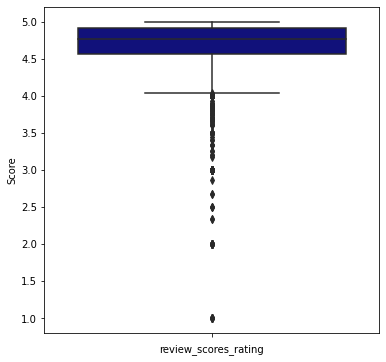

In [26]:
df_reviews = filtered_df.iloc[:, -10:-3]

fig, ax = plt.subplots(figsize=(6, 6))
sns.boxplot(y=df_reviews['review_scores_rating'], color='darkblue')
ax.set_xlabel('review_scores_rating')
ax.set_ylabel('Score')
plt.show()

**Figure 6. Distribution of Component Criteria Scores for Airbnb properties in Tokyo, Japan (Box-and-Whisker Plots)**

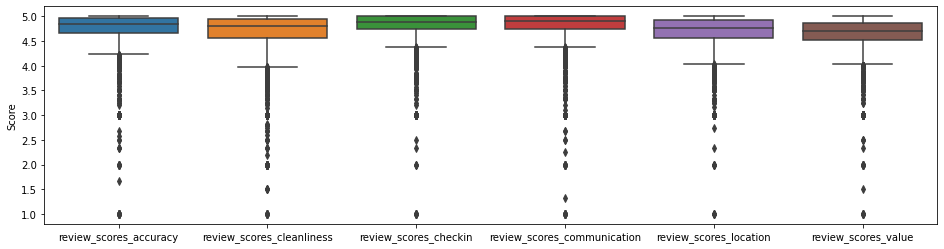

In [27]:
fix, ax = plt.subplots(figsize=(16, 4))
sns.boxplot(data=df_reviews.iloc[:, 1:])
ax.set_ylabel('Score')
plt.show()

**Figure 7. Distribution of Component Criteria Scores for Airbnb properties in Tokyo, Japan (Histograms)**

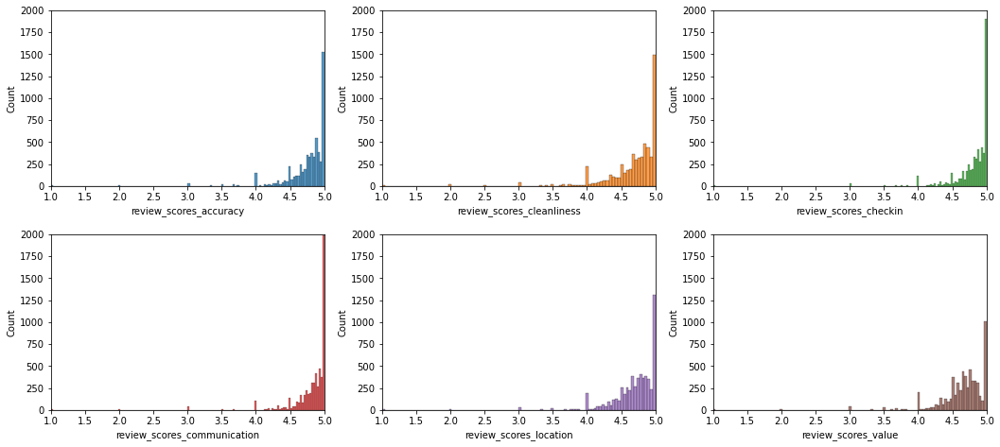

In [28]:
fig, ax = plt.subplots(2, 3, figsize=(15, 7))
fig.tight_layout(pad=3)

hist_color = {0: 'tab:blue', 1: 'tab:orange', 2: 'tab:green',
              3: 'tab:red', 4: 'tab:purple', 5: 'tab:brown'}

for i, col in enumerate(df_reviews.columns[1:]):
    sns.histplot(df_reviews[col], ax=ax[i//3, i % 3], color=hist_color[i])
    ax[i//3, i % 3].set_xlim(1, 5)
    ax[i//3, i % 3].set_ylim(0, 2000)

It can be seen from the plots that typically, listings generate respectable review scores between 4.5 and 5.  This is true for both overall scores and for individual criteria (with scores for check-in and communication especially tending to be quite high). As expected however, there are also listings that generate poor reviews, with scores below 4.0 observable across all scoring criteria below the 25th percentile.

#### **6.2 Dimensionality Reduction and Clustering**

Having explored the behavior and distributions of the numerous component features, for the  sections on this data exploration, the analysis then focused on applying dimensionality reduction using Truncated Singular Value Decomposition (SVD), as well as Agglomerative Clustering.

SVD was chosen as a dimensionality reduction technique since portions of the dataset is sparse, particularly the features resulting from one-hot encoding, and also since the data is zero-bounded which is preserved upon applying SVD. Before applying SVD on the whole dataset, the dataset was first separated into the feature sets of interest, namely those related to the quality of host service, those related to location and convenience, and a final set including key listing features and the overall review scores.  MinMax scaling was  performed to normalize the data and ensure comparability of features, while preservering data sparsity.SVD was then applied on each data subset, and plotted to prove some insight on what the singular values correspond to.  Singular values were retained such that at least 90% of the variance in the data would be kept, however for feature sets where only 1 or 2 singular values were needed to retain the target amount of information, 3 singular values were retained for 3D plotting purposes.

Having reduced the dimensions of the data subsets, clustering when then performed. Hierarchal clustering, specifically agglomerative clustering,was chosen to allow ease of fine-tuning on the number of clusters based on visual inspection of the resulting dendograms. Based on trial and error, it was found that Ward's Method was the best agglomerative clustering technique to be used on the different feature sets. Upon clustering, plots were constructed to show the distribution of clusters against a map of Tokyo, an interactive 2D bubble chart, and a 3D scatterplot, using the first three singular values as the plot axes.

To summarize the steps:
1. Select features of interest
2. Perform Min-Max scaling
3. Perform Truncated SVD and retain at least 3 SV's, or enough to explain 90% of the variance, whichever is greater
4. Plot the projection of the original features against the derived SV's using bar plots and a 3D interative plot
5. Perform agglomerative clustering and plot the resulting dendogram with the preferred threshold for clustering, as well as the clusters imposed on an interative map of Tokyo for initial visual inspection
6. Summarize the number of listings per cluster
7. Construct an interactive 2D bubble chart with the size of points scaled according to the listing price
8. Construct an interactive 3D scatter plot of the clusters using the top 3 singnular values as the plot axes

The interactive plots may be manipulated when viewing this report in HTML.  Maps may be explored by zooming or dragging to any side, the 3D plots may be adjusted by rotation in addition to zoom level, and clusters may be selected and deselected to facilitate close exploration and comparison.

In [29]:
def truncated_svd(X):
    """
    Perform truncated SVD on the input design matrix and returns the q matrix,
    sigma singular values matrix and p matrix of the SVD operation as well
    as the normalized sum of squared distance from the origin (nssd).

    Parameters
    ----------
    X : array
        input design matrix
    Returns
    -------
    q : array
        array containing the eigenvectors of XX.T
    sigma : array
        diagonal array containing the singular values of X
    p : array
        array containing the eigenvectors of X.TX
    nssd : array
        array containing the normalized sum of squared distances
    """
    q, s, p = np.linalg.svd(X)
    sigma = np.diag(s)
    p = p.T
    nssd = np.array([s[i]**2/np.sum(s**2)
                     for i in range(len(s))])
    return q, sigma, p, nssd


def plot_feature_importance_4SVs(features, p):
    """Plot the top 10 important features and their weights for each of the
    four singular values.

    Parameters
    ----------
    features : list
        list of dataset features
    p : array
        array containing the singular values
    """
    fig, ax = plt.subplots(2, 2, figsize=(12, 8))
    fig.tight_layout(h_pad=5, w_pad=18)
    ax = ax.flatten()

    # Plot only the 10 most significant features
    for j in range(4):
        features_weights = np.ravel(p[:, j:j+1])
        features_order = np.argsort(np.abs(features_weights))[::-1]
        features_sorted = [features[i] for i in features_order][:10][::-1]
        ax[j].barh(range(len(features_sorted)),
                   features_weights[features_order][:10][::-1], align='center')
        ax[j].set_yticks(range(len(features_sorted)))
        ax[j].set_yticklabels(features_sorted)
        ax[j].set_xlabel("Feature importance")
        ax[j].set_ylabel("Feature Weight")
        ax[j].set_xlim(-1, 1)
        ax[j].set_title(f'SV{j+1} Feature Importance')


def biplot_4SVs(X_new, features, p, nssd):
    """Plot the captured total variance across 4 singular values and generate
    biplots of the transformed data and feature weights across four singular
    values.

    Parameters
    ----------
    X_new : array
        array containing the transformed dataset
    features : list
        list of dataset features
    p : array
        array containing the singular values
    nssd : array
        array containing the captured variance per singular value
    """
    fig, ax = plt.subplots(3, 2, figsize=(18, 18))
    ax = ax.flatten()
    ax[0].scatter(X_new[:, 0], X_new[:, 1], edgecolor='blue')
    for feature, vec in zip(features, p):
        ax[0].arrow(0, 0, 2*vec[0], 2*vec[1], width=0.01, ec='none', fc='r')
        ax[0].text(2*vec[0], 2*vec[1], feature, ha='center', color='r',
                   fontsize=10)
    ax[0].autoscale(axis='y')
    ax[0].set_xlim(-5, 5)
    ax[0].set_xlabel('SV1')
    ax[0].set_ylabel('SV2')
    ax[0].set_title('SV2 vs. SV1 Biplot')

    ax[1].scatter(X_new[:, 0], X_new[:, 2], edgecolor='blue')
    for feature, vec in zip(features, p):
        ax[1].arrow(0, 0, 2*vec[0], 2*vec[2], width=0.01, ec='none', fc='r')
        ax[1].text(2*vec[0], 2*vec[2], feature, ha='center', color='r',
                   fontsize=10)
    ax[1].autoscale(axis='y')
    ax[1].set_xlim(-5, 5)
    ax[1].set_xlabel('SV1')
    ax[1].set_ylabel('SV3')
    ax[1].set_title('SV3 vs. SV1 Biplot')

    ax[2].scatter(X_new[:, 0], X_new[:, 3], edgecolor='blue')
    for feature, vec in zip(features, p):
        ax[2].arrow(0, 0, 2*vec[0], 2*vec[3], width=0.01, ec='none', fc='r')
        ax[2].text(2*vec[0], 2*vec[3], feature, ha='center', color='r',
                   fontsize=10)
    ax[2].autoscale(axis='y')
    ax[2].set_xlim(-5, 5)
    ax[2].set_xlabel('SV1')
    ax[2].set_ylabel('SV4')
    ax[2].set_title('SV4 vs. SV1 Biplot')

    ax[3].scatter(X_new[:, 1], X_new[:, 2], edgecolor='blue')
    for feature, vec in zip(features, p):
        ax[3].arrow(0, 0, 2*vec[1], 2*vec[2], width=0.01, ec='none', fc='r')
        ax[3].text(2*vec[1], 2*vec[2], feature, ha='center', color='r',
                   fontsize=10)
    ax[3].autoscale(axis='y')
    ax[3].set_xlim(-5, 5)
    ax[3].set_xlabel('SV2')
    ax[3].set_ylabel('SV3')
    ax[3].set_title('SV3 vs. SV2 Biplot')

    ax[4].scatter(X_new[:, 1], X_new[:, 3], edgecolor='blue')
    for feature, vec in zip(features, p):
        ax[4].arrow(0, 0, 2*vec[1], 2*vec[3], width=0.01, ec='none', fc='r')
        ax[4].text(2*vec[1], 2*vec[3], feature, ha='center', color='r',
                   fontsize=10)
    ax[4].autoscale(axis='y')
    ax[4].set_xlim(-5, 5)
    ax[4].set_xlabel('SV2')
    ax[4].set_ylabel('SV4')
    ax[4].set_title('SV4 vs. SV2 Biplot')

    ax[5].scatter(X_new[:, 2], X_new[:, 3], edgecolor='blue')
    for feature, vec in zip(features, p):
        ax[5].arrow(0, 0, 2*vec[2], 2*vec[3], width=0.01, ec='none', fc='r')
        ax[5].text(2*vec[2], 2*vec[3], feature, ha='center', color='r',
                   fontsize=10)
    ax[5].autoscale(axis='y')
    ax[5].set_xlim(-5, 5)
    ax[5].set_xlabel('SV3')
    ax[5].set_ylabel('SV4')
    ax[5].set_title('SV4 vs. SV3 Biplot')


def get_sv_count(nssd, thresh):
    """Determine number of SV's that will explain 90% of the variance."""
    fig, ax = plt.subplots(figsize=(18, 5))
    ax.plot(range(1, len(nssd)+1), nssd, '-', label='individual')
    ax.plot(range(1, len(nssd)+1), nssd.cumsum(), 'r-', label='cumulative')
    ax.axhline(thresh, ls='--', color='#808080')
    ax.legend()
    ax.set_xlim(0, len(nssd)+1)
    ax.set_xlabel('SV')
    ax.set_ylabel('variance explained')
    ax = ax.twinx()
    ax.set_ylabel('cumulative variance explained')
    ind = bisect.bisect(nssd.cumsum(), thresh) + 1
    print(f'\nTo achieve at least {thresh*100}%, {ind} SVs are required.')
    return ind


def predict_hierarchical_loc(df, method, t, show_dendogram=False):
    """Predict clusters based on agglomerative clustering."""
    Z = linkage(df, method=method, optimal_ordering=False)

    if show_dendogram:
        fig, ax = plt.subplots(figsize=(8, 5))
        set_link_color_palette(['red', 'blue', 'limegreen', 'purple',
                                'orange', 'yellow', 'goldenrod', 'brown',
                                'pink', 'cyan', 'salmon', 'teal', 'magenta',
                                'olive'])
        dn = dendrogram(Z, ax=ax, p=8,
                        truncate_mode='level',
                        color_threshold=t)
        plt.axhline(c='red', linestyle='--', y=t)
        ax.set_ylabel(r'h / $\Delta$')
        # fig.suptitle('Dendogram', fontsize=13)
        fig.tight_layout(pad=3)

    y_predict = fcluster(Z, t=t, criterion='distance')
    print('Method: ' + method.title() +
          f' ({len(set(y_predict))} clusters generated.)')
    return y_predict


def plot_hierarchal_loc(coord_df, y_predict):
    """Generate map of listings, color-coded by clusters."""
    colors = {1: 'red', 2: 'blue', 3: 'limegreen', 4: 'purple', 5: 'orange',
              6: 'yellow', 7: 'goldenrod', 8: 'brown', 9: 'pink', 10: 'cyan',
              11: 'salmon', 12: 'teal', 13: 'magenta', 0: 'olive'}

    fig = Figure(width=570, height=420)
    map = folium.Map(location=[(coord_df['latitude'].max() +
                                coord_df['latitude'].min())/2,
                               (coord_df['longitude'].max() +
                                coord_df['longitude'].min())/2],
                     width=550, height=400, zoom_start=9.5,
                     tiles='cartodbpositron')
    fg = folium.FeatureGroup(name="Clusters")
    for lat, lon, cluster in zip(coord_df['latitude'], coord_df['longitude'],
                                 y_predict):
        fg.add_child(folium.Circle(location=[lat, lon],
                                   radius=50, weight=3,
                                   color=colors[cluster % 14], fill=True,
                                   fill_color=colors[cluster % 14]))
    map.add_child(fg)
    fig.add_child(map)
    display(fig)

# 3D SV Plot
def plot_sv_3d(X_new, features, p, x=0, y=1, z=2):
    """Plot Singular Values in 3D.

    Parameters
    ----------
    X_new : numpy.ndarray
        Array of singular values
    features : list
        List of feature names
    p : numpy.ndarray
        P-matrix of SVD result (right singular matrix)
    x : float
        Index of singular value as 1st axis
    y : float
        Index of singular value as 2nd axis
    z : float
        Index of singular value as 3rd axis
    """
    fig = go.Figure()
    fig.update_layout(width=500, height=500)
    # Plot the points
    fig.add_trace(
        go.Scatter3d(x=X_new[:, x],
                     y=X_new[:, y],
                     z=X_new[:, z],
                     mode='markers',
                     marker=dict(size=5,
                                 colorscale='Viridis',
                                 opacity=0.8),
                     showlegend=False))
    # Change Axis Labels
    fig.update_layout(scene=dict(
        xaxis_title=f'SV{x+1}',
        yaxis_title=f'SV{y+1}',
        zaxis_title=f'SV{z+1}'),
                      width=700,
                      margin=dict(r=20, b=10, l=10, t=10))
    # Mean component values
    mean_x = p[:, x].mean()
    mean_y = p[:, y].mean()
    mean_z = p[:, z].mean()

    # Vector Multiplier
    mult = max(p[:, x].max(), p[:, y].max(), p[:, z].max())*1.5
    # Plot the lines
    for feature, vec in zip(features, p):
        fig.add_trace(go.Scatter3d(
            x=[mean_x, vec[x]*mult],
            y=[mean_y, vec[y]*mult],
            z=[mean_z, vec[z]*mult],
            mode='lines',
            showlegend=False,
            line=dict(color='orange')))
    # Plot feature annotations
    fig.update_layout(scene=dict(annotations=[dict(showarrow=False,
                                                   x=vec[x]*mult,
                                                   y=vec[y]*mult,
                                                   z=vec[z]*mult,
                                                   text=feature,
                                                   textangle=0,
                                                   xshift=10,
                                                   opacity=1.0,
                                                   font=dict(color='orange',
                                                             size=12))
                                              for feature,
                                              vec in zip(features, p)]),
                      title="Singular Value Plot")
    # Tight Layout
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    #fig.show(renderer='colab')
    fig.show(renderer='notebook')

In [30]:
coords = filtered_df[['latitude', 'longitude']].astype(float).copy()

##### **6.2.1 Clustering Based on Quality of Host Service**

The first dimension considered likely to be of interest to travelers was the quality of service.  To allow clustering based on this dimension, the following features were chosen to gauge the host's level of service:
- `host_age` - level of experience of the host
- `host_response_time` - how quickly the host responds to inquiries
- `host_response_rate` - how consistently the host responds to queries
- `host_acceptance_rate` - how consistently the host approves booking requests
- `instant_bookable` - whether or not the host is selective or open to accepting bookings
- `review_scores_accuracy` - rates how honesty and accurately the host describes their listing on the Airbnb platform
- `review_scores_checkin` - rates how well the host has provided a seamless check-in experience
- `review_scores_communication` - rates how well the host communicates with guests
- `review_scores_cleanliness` - rates how well the host keeps the property clean and pleasant for guests

The `host_is_superhost` feature will not be used as one of the features, since this is already the classification used by the Airbnb platform and may dominate the results. More significantly, it was considered more fruitful to explore alternative host segmentations.

In [31]:
service_df = filtered_df[['host_age',
                          'host_response_time', 'host_response_rate',
                          'host_acceptance_rate', 'instant_bookable',
                          'review_scores_accuracy', 'review_scores_checkin',
                          'review_scores_communication',
                          'review_scores_cleanliness']]
service_features = list(service_df.columns)

Upon applying SVD to this feature set, it was found that:
- SV1 alone was sufficient to account for over 90% of the variation in the data. This SV relates roughly equally to the host response rate and acceptance rate, the relevant rating scores, and to whether the listing allows Instant Booking
- SV2 relates mainly to whether the listing allows Instant Booking
- SV3 relates mainly to the host response time and host experience (i.e. `host_age`)
- SV4 relates mainly to host experience, although it was not deemed necessary to retain this SV

**Figure 8. Singular Value Decomposition on Features Related to the Quality of Host Service**


To achieve at least 90.0%, 1 SVs are required.


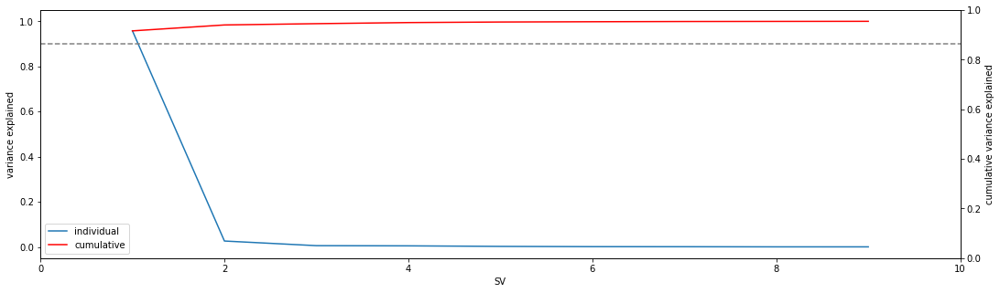

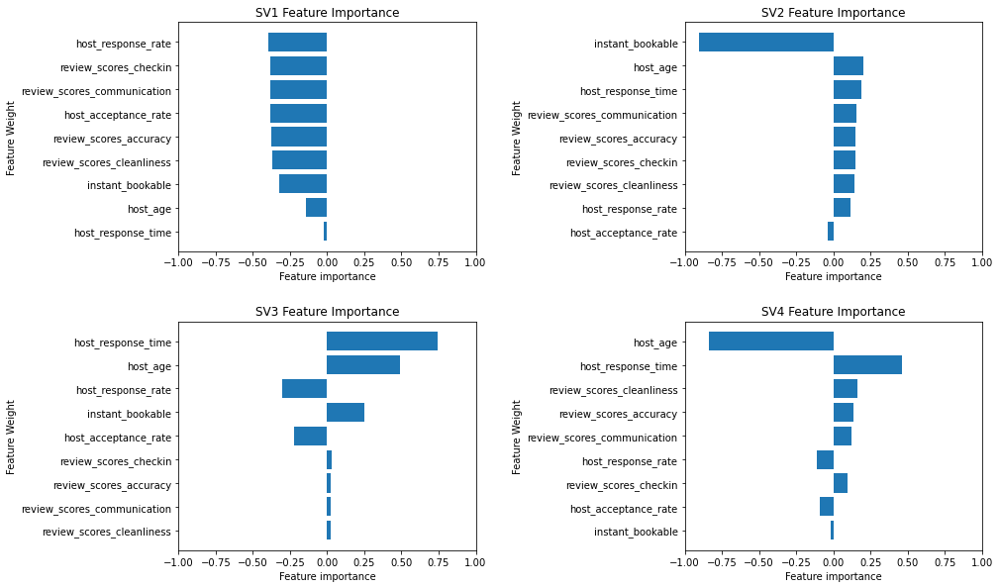

In [32]:
# Use MinMaxScaler to avoid negative values for sparse data
scaler = MinMaxScaler()
svd_norm_df = scaler.fit_transform(service_df)
q_service, s_service, p_service, nssd_service = truncated_svd(svd_norm_df)

sv_count = max([3, get_sv_count(nssd_service, 0.9)])

# Project normalized host data onto the optimal n singular values
X_service = svd_norm_df.dot(p_service[:, :sv_count])

# Plot feature importance across top singular values
plot_feature_importance_4SVs(service_features, p_service)

**Figure 9. 3D Plot of Data and Projection of Original Features with respect to the Top 3 Singular Values for Quality of Host Service**

In [33]:
# Generate 3D plot of the data with respect to 3 SV's
plot_sv_3d(X_service, service_features, p_service, x=0, y=1, z=2)

Upon applying agglomerative clustering using Ward's method, it was found upon inspection of the dendogram that 4 clusters may be usefully constructed from the data. This was plotted on a map to show the geographical distribution of the clusters. The comparative size of the clusters were plotted as well, showing that Cluster 2 contained the most listings, followed by Clusters 1, 3, then 4.

**Figure 10. Dendogram of Hierarchal Clustering based on Quality of Host Service**

Method: Ward (4 clusters generated.)


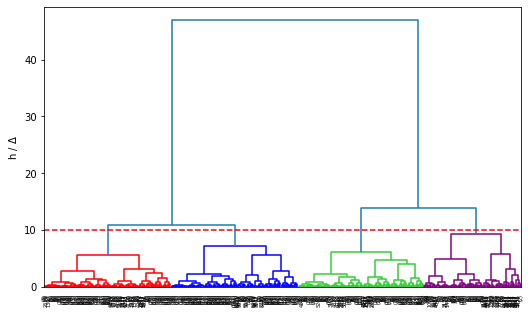

In [34]:
# Clustering based on host service features

service_methods = [('ward', 10)]

for method in service_methods:
    y_pred = predict_hierarchical_loc(X_service, method[0], method[1],
                                      show_dendogram=True)

**Figure 11. Map of Clustering based on Quality of Host Service**

In [35]:
plot_hierarchal_loc(coords, y_pred)

**Figure 12. Cluster Size Distribution for Clustering based on Quality of Host Service**

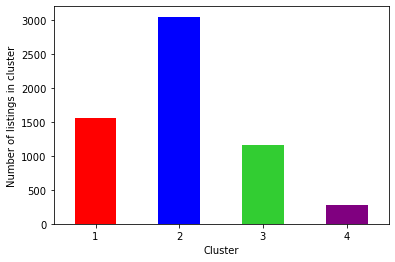

In [36]:
# Add cluster labels to the original data
final_clusters = np.zeros(len(y_pred))
for j in np.unique(y_pred):
    final_clusters[np.argwhere(y_pred == j)] = j
service_df['cluster'] = final_clusters.astype(int)
colors = ['red', 'blue', 'limegreen', 'purple', 'orange', 'yellow',
          'goldenrod', 'brown', 'pink', 'cyan', 'salmon', 'teal', 'magenta',
          'olive']
service_df['cluster'].value_counts().sort_index().plot(kind='bar',
                                                       color=colors)
plt.xticks(rotation=0)
plt.ylabel('Number of listings in cluster')
plt.xlabel('Cluster')
plt.show()

In [37]:
# Add back price and location features to the original data
addtl_df = filtered_df[['price', 'latitude', 'longitude']]
service_df = pd.concat([service_df, addtl_df], axis=1)

Another visual representation of the clusters is via a bubble chart, which allows plotting of a fourth dimension using the size of the bubbles (in addition to longitude, latitude, and cluster represented by the x-axis, y-axis, and color, respectively). This allows exploration of whether certain clusters of listings tend to be more expensive to book than others, although no discernible pattern appears.

**Figure 13. Bubble Chart by Price, Latitude, and Longitude, for Clustering based on Quality of Host Service**

In [38]:
# Create interactive 2D scatter plot for the generated clusters
# Size represents price
scatter2d_df = service_df.copy()
scatter2d_df = scatter2d_df.sort_values(by='cluster')
scatter2d_df['cluster'] = scatter2d_df['cluster'].astype(int).astype(str)
fig = px.scatter(scatter2d_df, x="longitude", y="latitude",
                 color="cluster",
                 color_discrete_sequence=['red',
                                          'blue',
                                          'limegreen',
                                          'purple',
                                          'orange',
                                          'yellow',
                                          'goldenrod',
                                          'brown',
                                          'pink',
                                          'cyan',
                                          'salmon',
                                          'teal',
                                          'magenta',
                                          'olive'],
                #  title='Airbnb Clusters by Latitude/Longitude',
                 template='seaborn', opacity=0.5, size='price')
fig.update_yaxes(
    scaleanchor="y",
    scaleratio=1,
  )
fig.show()

Finally, a 3D representation of the clusters was created, by plotting against the top 3 SV's. It shows quite good separation among the clusters, with distinct cluster boundaries and minimal overlap.

**Figure 14. 3D SV Representation of Clustering based on Quality of Host Service**

In [39]:
# Visualize the clusters in SV 3d space
scatter3d_df = pd.concat([pd.DataFrame(X_service),
                          service_df.reset_index()['cluster']], axis=1)
clusters_num = len(np.unique(y_pred))
scatter3d_df = scatter3d_df.sort_values(by='cluster')
scatter3d_df['cluster'] = scatter3d_df['cluster'].astype(int).astype(str)
fig = px.scatter_3d(
    scatter3d_df, x=0, y=1, z=2, color='cluster',
    color_discrete_sequence=['red', 'blue', 'limegreen', 'purple', 'orange',
                             'yellow', 'goldenrod', 'brown', 'pink', 'cyan',
                             'salmon', 'teal', 'magenta', 'olive'],
    # title=f"SV Representation of the {clusters_num} Airbnb Clusters",
    labels={'0': 'SV 1', '1': 'SV 2', '2': 'SV 3'},
    width=600, height=600)
fig.update(layout_coloraxis_showscale=False)

##### **6.2.2 Clustering Based on Location and Convenience**

Being highly cosmopolitan, Tokyo is well connected by its efficient transport systems. However, location, accessibility, and ease of check-in could be high on guests’ priority in looking for listings. To better drill down into this, we chose the following features:

* `latitude` - latitude coordinate of listing
* `longitude` - longitude coordinate of listing
* `review_scores_checkin` - average checkin review rating
* `review_scores_location` - average location review rating

In giving review scores, the guests need to keep in mind the following:
* Check-in
  - Was it easy and seamless?
* Location
 - Was the guest made aware of safety, transportation, points of interest and special considerations like noise or other situations that might affect their stay?

The last mentioned feature can be quite controversial for hosts. They’ve raised that they are being rated on something that is out of their control. AirBnb’s response to this is to further probe into guests ratings when they’ve given a score of 3 and below by asking a follow-up question: “Was the listing not described accurately?” - for further information on the reasons for the low score.


In [40]:
# Convenience Data Set
convenience_df = filtered_df[['latitude', 'longitude',
                              'review_scores_checkin',
                              'review_scores_location']]
convenience_features = list(convenience_df)

Upon applying SVD to this feature set, it was found that:
* SV1 alone was sufficient to account for over 90% of the variation in the data. This SV relates roughly equally to the checking review and location review scores, and whether the listing allows Instant Booking
* SV2 relates mainly to the latitude (northern or southern location) of the listing
* SV3 relates mainly to host longitude (western or eastern location) of the listing
* SV4 relates mainly to check-in and location review scores, though at opposing directions

**Figure 15. Singular Value Decomposition on Features Related to Location and Convenience**


To achieve at least 90.0%, 1 SVs are required.


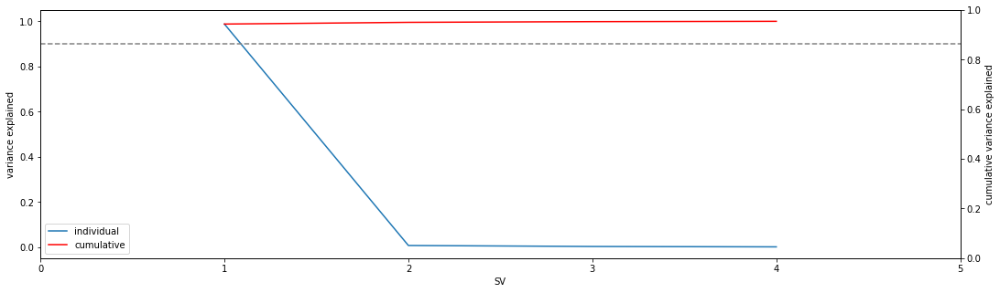

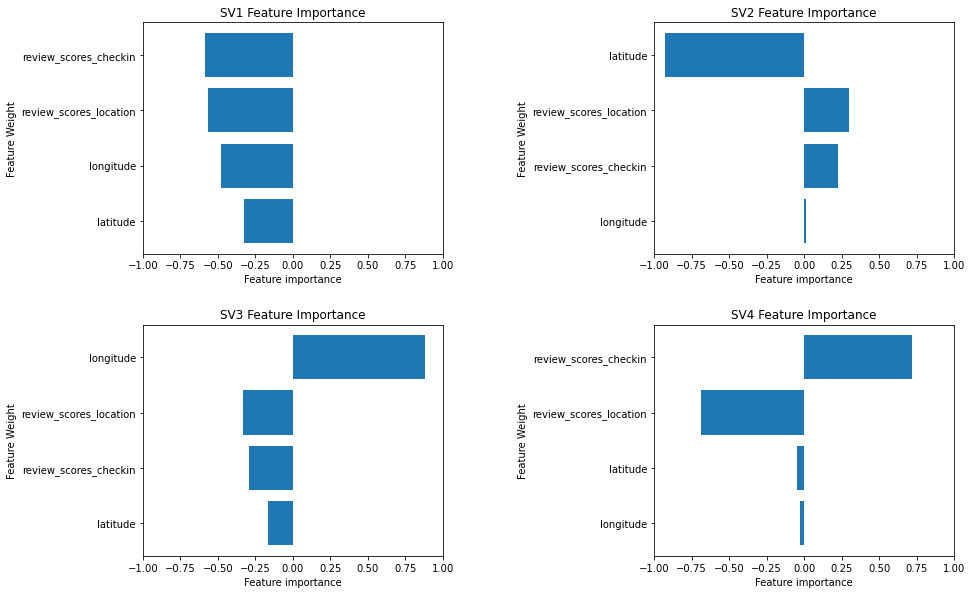

In [41]:
# Use MinMaxScaler to avoid negative values for sparse data
svd_conv_df = scaler.fit_transform(convenience_df)
q_conv, s_conv, p_conv, nssd_conv = truncated_svd(svd_conv_df)

sv_count = max([3, get_sv_count(nssd_conv, 0.9)])

# Project normalized host data onto the optimal n singular values
X_conv = svd_conv_df.dot(p_conv[:, :sv_count])

# Plot feature importance across top singular values
plot_feature_importance_4SVs(convenience_features, p_conv)

**Figure 16. 3D Plot of Data and Projection of Original Features with respect to the Top 3 Singular Values for Location and Convenience**

In [42]:
# Generate 3D plot of the data with respect to 3 SV's
plot_sv_3d(X_conv, convenience_features, p_conv, x=0, y=1, z=2)

**Figure 17. Dendogram of Hierarchal Clustering based on Location and Convenience**

Method: Ward (3 clusters generated.)


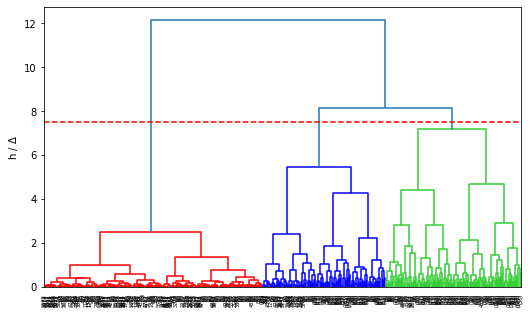

In [43]:
# Clustering based on convenience features
conv_methods = [('ward', 7.5)]

for method in conv_methods:
    y_pred = predict_hierarchical_loc(X_conv, method[0], method[1],
                                      show_dendogram=True)

**Figure 18. Map of Clustering based on Location and Convenience**

In [44]:
plot_hierarchal_loc(coords, y_pred)

**Figure 19. Cluster Size Distribution for Clustering based on Location and Convenience**

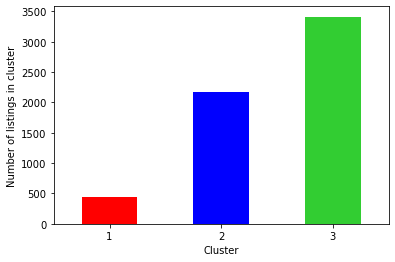

In [45]:
# Add cluster labels to the original data
final_clusters = np.zeros(len(y_pred))
for j in np.unique(y_pred):
    final_clusters[np.argwhere(y_pred == j)] = j
convenience_df['cluster'] = final_clusters.astype(int)
colors = ['red', 'blue', 'limegreen', 'purple', 'orange', 'yellow',
          'goldenrod', 'brown', 'pink', 'cyan', 'salmon', 'teal', 'magenta',
          'olive']
convenience_df['cluster'].value_counts().sort_index().plot(kind='bar',
                                                           color=colors)
plt.xticks(rotation=0)
plt.ylabel('Number of listings in cluster')
plt.xlabel('Cluster')
plt.show()

In [46]:
# Add back price ato the original data
addtl_df = filtered_df[['price']]
convenience_df = pd.concat([convenience_df, addtl_df], axis=1)

**Figure 20. Bubble Chart by Price, Latitude, and Longitude, for Clustering based on Location and Convenience**

In [47]:
# Create interactive 2D scatter plot for the generated clusters
# Size represents price
scatter2d_df = convenience_df.copy()
scatter2d_df = scatter2d_df.sort_values(by='cluster')
scatter2d_df['cluster'] = scatter2d_df['cluster'].astype(int).astype(str)
fig = px.scatter(scatter2d_df, x="longitude", y="latitude",
                 color="cluster",
                 color_discrete_sequence=['red',
                                          'blue',
                                          'limegreen',
                                          'purple',
                                          'orange',
                                          'yellow',
                                          'goldenrod',
                                          'brown',
                                          'pink',
                                          'cyan',
                                          'salmon',
                                          'teal',
                                          'magenta',
                                          'olive'],
                #  title='Airbnb Clusters by Latitude/Longitude',
                 template='seaborn', opacity=0.5, size='price')
fig.update_yaxes(
    scaleanchor="y",
    scaleratio=1,
  )
fig.show()

**Figure 21. 3D SV Representation of Clustering based on Location and Convenience**

In [48]:
# Visualize the clusters in SV 3d space
scatter3d_df = pd.concat([pd.DataFrame(X_conv),
                          convenience_df.reset_index()['cluster']], axis=1)
clusters_num = len(np.unique(y_pred))
scatter3d_df = scatter3d_df.sort_values(by='cluster')
scatter3d_df['cluster'] = scatter3d_df['cluster'].astype(int).astype(str)
fig = px.scatter_3d(
    scatter3d_df, x=0, y=1, z=2, color='cluster',
    color_discrete_sequence=['red', 'blue', 'limegreen', 'purple', 'orange',
                             'yellow', 'goldenrod', 'brown', 'pink', 'cyan',
                             'salmon', 'teal', 'magenta', 'olive'],
    # title=f"SV Representation of the {clusters_num} Airbnb Clusters",
    labels={'0': 'SV 1', '1': 'SV 2', '2': 'SV 3'},
    width=600, height=600)
fig.update(layout_coloraxis_showscale=False)

##### **6.2.3 Clustering Based on Key Listing Features and Overall Experience**

Lastly, we take a look at the listing features itself and some selected review features. The selected features are shown below:
- the one-hot encoded neigborhood features from `Adachi_Ku` to `Toshima_Ku`
- the one-hot encoded room type features from `Entire_home/apt` to `Shared_room`
- `latitude` - latitude coordinate of listing
- `longitude` - longitude coordinate of listing
- `accommodates` - number of people that a listing can accommodate
- `bathrooms_num` - number of bathrooms of a listing
- `bedrooms` - number of bedrooms of a listing
- `beds` - number of beds of a listing
- `amenities_num` - number of given amenities of a listing
- `price` - listed daily price of a listing, in local currency
- `minimum_nights` - minimum nights required to be booked for a listing
- `availablity_365` - availability of a listing 365 days in the future. Lower availability means a listing is booked for most of the year but an availability of 0 means the host has temporarily disabled a listing for booking.
- `review_scores_rating` - average overall review rating
- `reviews_per_month` - average number of reviews per month

The first 10 features listed above describe the listing in terms of location, price and furnishing. The last four features might be of interest for guests. Minimum nights dictate the minimum spending for guest on a chosen listing while availability indicate how in demand the listing is. Finally, reviews scores rating and reviews per month represent the reputation of the listing in terms of how previous guests rated their overall experience and how frequent a listing is being booked.

In [49]:
# Prepare selected features
overall_df = filtered_df[['Adachi_Ku', 'Akiruno_Shi', 'Akishima_Shi',
                          'Arakawa_Ku', 'Bunkyo_Ku', 'Chiyoda_Ku', 'Chofu_Shi',
                          'Chuo_Ku', 'Edogawa_Ku', 'Fuchu_Shi',
                          'Hachioji_Shi', 'Hamura_Shi', 'Higashikurume_Shi',
                          'Higashimurayama_Shi', 'Hino_Shi', 'Itabashi_Ku',
                          'Katsushika_Ku', 'Kita_Ku', 'Kodaira_Shi',
                          'Koganei_Shi', 'Kokubunji_Shi', 'Komae_Shi',
                          'Koto_Ku', 'Kunitachi_Shi', 'Machida_Shi',
                          'Meguro_Ku', 'Minato_Ku', 'Mitaka_Shi',
                          'Musashimurayama_Shi', 'Musashino_Shi', 'Nakano_Ku',
                          'Nerima_Ku', 'Nishitokyo_Shi', 'Okutama_Machi',
                          'Ome_Shi', 'Ota_Ku', 'Setagaya_Ku', 'Shibuya_Ku',
                          'Shinagawa_Ku', 'Shinjuku_Ku', 'Suginami_Ku',
                          'Sumida_Ku', 'Tachikawa_Shi', 'Taito_Ku', 'Tama_Shi',
                          'Toshima_Ku', 'latitude', 'longitude',
                          'Entire_home/apt', 'Hotel_room', 'Private_room',
                          'Shared_room', 'accommodates', 'bathrooms_num',
                          'bedrooms', 'beds', 'amenities_num', 'price',
                          'minimum_nights', 'availability_365',
                          'review_scores_rating', 'reviews_per_month']]

overall_features = list(overall_df.columns)

Upon applying SVD to this feature set, it was found that 11 SVs was enough to capture 90% of the data variation and the following SV relationships were observed:
- SV1 relates roughly equally to review scores rating, whether a listing is an entire home/apartment and longitude of a listing.
- SV2 relates mainly to whether the listing is a private room (negative direction) or an entire home/apartment (positive direction).
- SV3 relates mainly to whether a listing is located in Shinjuku Ku (negative direction) or Taito Ku (positive direction).
- SV3 relates mainly to whether a listing is located in Sumida Ku (negative direction) or Taito Ku (positive direction).

Based from the insights above, we can already see that room type and neighborhood feature prominently across the top SVs. We will observe the importance of these two features again when we do clustering.  

**Figure 22. Singular Value Decomposition on Features Related to the Key Listing Features**



To achieve at least 90.0%, 11 SVs are required.


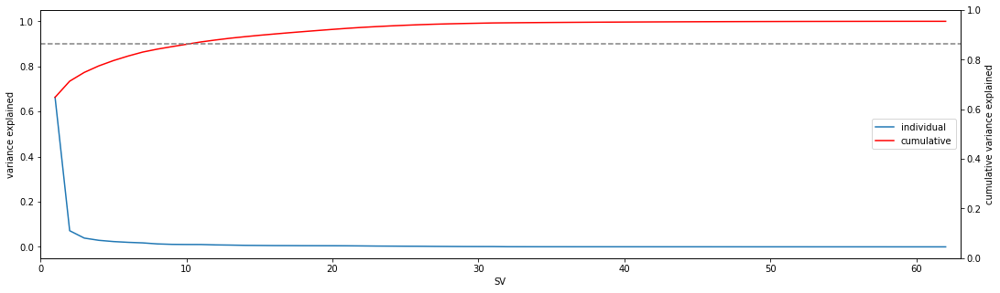

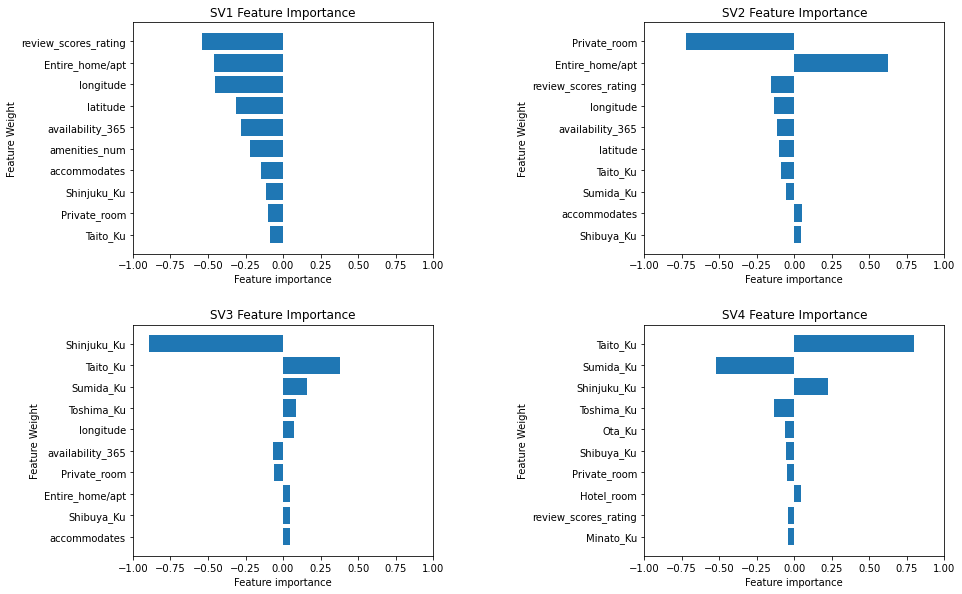

In [50]:
# Use MinMaxScaler to avoid negative values for sparse data
scaler = MinMaxScaler()
svd_norm_df = scaler.fit_transform(overall_df)
q_all, s_all, p_all, nssd_all = truncated_svd(svd_norm_df)

sv_count = max([3, get_sv_count(nssd_all, 0.9)])
# Project normalized host data onto the optimal n singular values
X_all = svd_norm_df.dot(p_all[:, :sv_count])

# Plot feature importance across top singular values
plot_feature_importance_4SVs(overall_features, p_all)

The figure below shows the dimensionally reduced dataset represented across 3 SVDs. We can already see clusters form among the data points. We will formally do clustering in the next section. 

**Figure 23. 3D Plot of Data and Projection of Original Features with respect to the Top 3 Singular Values for Key Listing Features**

In [51]:
# Generate 3D plot of the data with respect to 3 SV's
plot_sv_3d(X_all, overall_features, p_all, x=0, y=1, z=2)

Agglomerative clustering using Ward's method was done on the dimensionally reduced dataset. At a delta threshold of 16, 13 clusters were generated.

**Figure 24. Dendogram of Hierarchal Clustering based on Key Listing Features**

Method: Ward (13 clusters generated.)


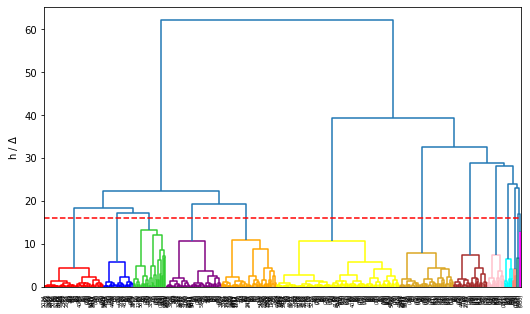

In [52]:
# Clustering based on overall listing features

overall_methods = [('ward', 16)]

for method in overall_methods:
    y_pred = predict_hierarchical_loc(X_all, method[0], method[1],
                                      show_dendogram=True)

The figure below shows the generated clusters superimposed over a map of Tokyo. Aside from the purple, green and orange clusters, we can see that clusters particularly form over a specific area on the map. 

**Figure 25. Map of Clustering based on Key Listing Features**

In [53]:
plot_hierarchal_loc(coords, y_pred)

Next, we look at the count of listings per cluster. We can see that Cluster 13, 6 and 3 contain the highest number of listings. The high number of listings for Cluster 13 and 3 make sense since these clusters are scattered across Tokyo. Meanwhile, Cluster 6 only comprises of listings over a specific area.

**Figure 26. Cluster Size Distribution for Clustering based Key Listing Features**

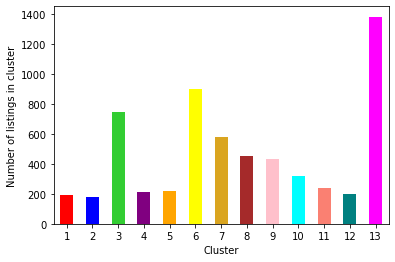

In [54]:
# Add cluster labels to the original data
final_clusters = np.zeros(len(y_pred))
for j in np.unique(y_pred):
    final_clusters[np.argwhere(y_pred == j)] = j
overall_df['cluster'] = final_clusters.astype(int)
colors = ['red', 'blue', 'limegreen', 'purple', 'orange', 'yellow',
          'goldenrod', 'brown', 'pink', 'cyan', 'salmon', 'teal', 'magenta',
          'olive']
overall_df['cluster'].value_counts().sort_index().plot(kind='bar',
                                                       color=colors)
plt.xticks(rotation=0)
plt.ylabel('Number of listings in cluster')
plt.xlabel('Cluster')
plt.show()

The figure below is a 2D scatter plot of the clusters across latitude and longitude. This figure essentially replicates Figure 25 but with added functionality of viewing the price per listing and interactivity. The reader may choose to select/deselect each cluster to see the relative location of each cluster with respect to the other clusters.

**Figure 27. Bubble Chart by Price, Latitude, and Longitude, for Clustering based on Key Listing Features**

In [55]:
# Create interactive 2D scatter plot for the generated clusters
# Size represents price and symbol represents room type
scatter2d_df = overall_df.copy()
scatter2d_df = scatter2d_df.sort_values(by='cluster')
scatter2d_df['cluster'] = scatter2d_df['cluster'].astype(int).astype(str)
fig = px.scatter(scatter2d_df, x="longitude", y="latitude",
                 color="cluster",
                 color_discrete_sequence=['red',
                                          'blue',
                                          'limegreen',
                                          'purple',
                                          'orange',
                                          'yellow',
                                          'goldenrod',
                                          'brown',
                                          'pink',
                                          'cyan',
                                          'salmon',
                                          'teal',
                                          'magenta',
                                          'olive'],
                #  title='Airbnb Clusters by Latitude/Longitude',
                 template='seaborn', opacity=0.5, size='price')
fig.update_yaxes(
    scaleanchor="y",
    scaleratio=1,
  )
fig.show()

The figure below shows the generated clusters across 3 SVs. We can see that the agglomerative clustering performs really well in generating compact and well-defined clusters.

**Figure 28. 3D SV Representation of Clustering based on Key Listing Features**

In [56]:
# Visualize the clusters in SV 3d space
scatter3d_df = pd.concat([pd.DataFrame(X_all),
                          overall_df.reset_index()['cluster']], axis=1)
clusters_num = len(np.unique(y_pred))
scatter3d_df = scatter3d_df.sort_values(by='cluster')
scatter3d_df['cluster'] = scatter3d_df['cluster'].astype(int).astype(str)
fig = px.scatter_3d(
    scatter3d_df, x=0, y=1, z=2, color='cluster',
    color_discrete_sequence=['red', 'blue', 'limegreen', 'purple', 'orange',
                             'yellow', 'goldenrod', 'brown', 'pink', 'cyan',
                             'salmon', 'teal', 'magenta', 'olive'],
    # title=f"SV Representation of the {clusters_num} Airbnb Clusters",
    labels={'0': 'SV 1', '1': 'SV 2', '2': 'SV 3'},
    width=600, height=600)
fig.update(layout_coloraxis_showscale=False)

In [57]:
# Add back decoded room type data for insights interpretation
room_df = overall_df[['Entire_home/apt', 'Hotel_room', 'Private_room',
       'Shared_room']]

overall_df = pd.concat([overall_df, 
                        pd.DataFrame(room_df.idxmax(1))], 
                       axis=1).rename(columns={0: 'room_type'})

# Add back decoded neighborhood data for insights interpretation
neighborhood_df = overall_df[['Adachi_Ku', 'Akiruno_Shi', 'Akishima_Shi', 
                              'Arakawa_Ku', 'Bunkyo_Ku', 'Chiyoda_Ku', 
                              'Chofu_Shi', 'Chuo_Ku', 'Edogawa_Ku', 'Fuchu_Shi',
                              'Hachioji_Shi', 'Hamura_Shi', 'Higashikurume_Shi',
                              'Higashimurayama_Shi', 'Hino_Shi', 'Itabashi_Ku', 
                              'Katsushika_Ku', 'Kita_Ku', 'Kodaira_Shi', 
                              'Koganei_Shi', 'Kokubunji_Shi', 'Komae_Shi',
                              'Koto_Ku', 'Kunitachi_Shi', 'Machida_Shi', 
                              'Meguro_Ku', 'Minato_Ku', 'Mitaka_Shi', 
                              'Musashimurayama_Shi', 'Musashino_Shi', 
                              'Nakano_Ku', 'Nerima_Ku', 'Nishitokyo_Shi', 
                              'Okutama_Machi', 'Ome_Shi', 'Ota_Ku',
                              'Setagaya_Ku', 'Shibuya_Ku', 'Shinagawa_Ku', 
                              'Shinjuku_Ku', 'Suginami_Ku', 'Sumida_Ku', 
                              'Tachikawa_Shi', 'Taito_Ku', 'Tama_Shi',
                              'Toshima_Ku']]

overall_df = pd.concat([overall_df, 
                        pd.DataFrame(neighborhood_df.idxmax(1))], 
                       axis=1).rename(columns={0: 'neighborhood'})

### **7 Results and Discussion**

#### **7.1 Clustering Interpretations and Insights**

##### **7.1.1 Insights on Quality of Host Service Clusters**

To interpret the clusters derived from the analysis of features related to host service quality, a heatmap was constructed, with green indicating high or favorable metrics, and red indicating low or unfavorable metrics.  For instance, clusters with a comparatively short average response time is marked as green for that feature, while a cluster with low host experience (age) is marked as red.  For moderate scores, they are marked in lighter shades.

**Figure 29. Heatmap for Clusters based on Quality of Host Service**

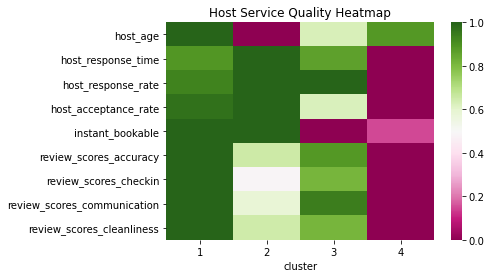

In [58]:
service_summary = (service_df.
                   groupby('cluster')['host_age', 'host_response_time',
                                      'host_response_rate',
                                      'host_acceptance_rate',
                                      'instant_bookable',
                                      'review_scores_accuracy',
                                      'review_scores_checkin',
                                      'review_scores_communication',
                                      'review_scores_cleanliness'].mean())
clusters = service_summary.index
features = service_summary.columns
service_summary = pd.DataFrame(scaler.fit_transform(service_summary))
service_summary.columns = features
service_summary.index = clusters
service_summary['host_response_time'] = (1 -
                                         service_summary['host_response_time'])
sns.heatmap(service_summary.T, cmap='PiYG')
plt.title('Host Service Quality Heatmap')
plt.show()

From the heatmap, the significance of the clusters are evident:
- **Cluster 1: Experienced hosts, excellent service** -  This corresponds to listings managed by hosts who are committed to the Airbnb platform and have learned to provide excellent service. They consistently allow Instant Booking.
- **Cluster 2: Inexperienced but eager hosts, moderate service** - This corresponds to listings managed by new or inexperienced hosts.  They are very eager to respond quickly and accept bookings, but have yet to excel in service or earn high review scores. Like Cluster 1, they allow Instant Booking.
- **Cluster 3: Moderately experienced but selective hosts, good service** - This might be seen as the "middle ground", corresponding to listings managed by established hosts who provide a moderate to high level of service. They are more selective in their guests as they do not allow Instant Booking, but they do tend to be very good at communicating and responding to inquiries.
- **Cluster 4: Long-time hosts, poor service** - This corresponds to listings managed by hosts who have been on on the platform a long time, but are not committed to providing good service, resulting in the poorest review scores among the clusters. Some listings are likely dormant or not actively managed. Most do not allow Instant Booking.

##### **7.1.2 Insights on Location and Convenience Clusters**

Similar to the previous section, Convenience Clusters will be evaluated using heat maps on their location and check-in scores.

**Table 3. Summary of Location and Convenience Clusters**

In [59]:
# Feature Summary Per Cluster
pivot_convenience = pd.pivot_table(convenience_df,
                                   index='cluster',
                                   aggfunc='mean')
display(pivot_convenience)

,latitude,longitude,price,review_scores_checkin,review_scores_location
cluster,,,,,
1,35.581397,139.722200,16986.475225,4.826261,4.714302
2,35.686663,139.685423,19620.288470,4.882761,4.806311
3,35.715370,139.771178,14587.637668,4.752329,4.621646


**Figure 30. Heatmap for Clusters based on Location and Convenience**

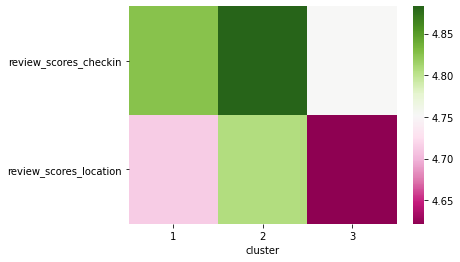

In [60]:
sns.heatmap(pivot_convenience[['review_scores_checkin',
                               'review_scores_location']].T,
            cmap='PiYG')
plt.show()

By doing a quick check on the map plotted above as well as the heatmap, the following can be said of the formed clusters:

* **Cluster 1: Nearest Haneda Airport**
  -	Better location and check-in scores

  This cluster is nearest to Haneda Airport. The drawback in this area is the proximity to the main attractions that Tokyo offers are farther compared to listings from clusters 2 and 3. On a 3-tier comparison of scores, this can be classified to have ‘better’ scores on both location and ease of checking in.

* **Cluster 2: Central and Westernmost Listings**
  -	Best location and check-in scores
	
  This cluster seem to have the best location and check-in scores among the formed clusters. It contains Shinjuku and Shibuya areas which are highly accessible to public transport, as well as tourist attractions.

* **Cluster 3: Northern Block**
  -	Good location and check-in scores
	
  This cluster rated the lowest on both location and check-in scores among the clusters, despite being in relatively prime locations such as Ikebukuro, Akihabara, and Asakusa. This cluster is also the farthest from Haneda International Airport.


##### **7.1.3 Insights on Key Listing Features and Overall Experience Clusters**

The table below shows the average listing feature values per cluster and the room types and neighborhood composition per cluster.

Looking at the `single_neigborhood` column, 10 of the 13 clusters have listings found in only one neighborhood unique to that cluster. For clusters with more than one neigborhood, the neighborhood with the most listings are shown in the `top_neighborhood` column.

Looking at `room_type`, we can also see that 10 of the 13 clusters have distinct room types with only cluster 3, 4 and 5 having mixed room types.

As hinted before in Section 6.2.3, this shows how the clustering mainly centered around location and room type.

**Table 4. Summary of Clusters based on Key Listing Features and Overall Experience**

In [61]:
# Create cluster summary dataframe with listing feature means as well as
# room type and neighborhood. If cluster has more than one neighborhood, only
# show neighborhood with the most listings in the cluster and indicate that
# cluster is not a single neighborhood cluster
insight_df = pd.DataFrame()
clusters = sorted(overall_df['cluster'].unique())
insight_df['cluster'] = clusters
insight_df['single_neighborhood'] = [0 if len(overall_df
                                              [overall_df['cluster'] == x]
                                              ['neighborhood'].unique()) > 1
                                     else 1 for x in clusters]
insight_df['top_neigborhood'] = ([overall_df[overall_df['cluster'] == x]
                                  ['neighborhood'].value_counts().index[0]
                                  for x in clusters])
insight_df['room_type'] = ([overall_df[overall_df['cluster'] == x]
                           ['room_type'].unique().tolist() for x in clusters])
insight_df = insight_df.set_index('cluster')

mean_df = overall_df.iloc[:, -13:-2].groupby(by='cluster').mean().round(2)
insight_df = pd.concat([insight_df, mean_df], axis=1)
insight_df

,single_neighborhood,top_neigborhood,room_type,accommodates,bathrooms_num,bedrooms,beds,amenities_num,price,minimum_nights,availability_365,review_scores_rating,reviews_per_month
cluster,,,,,,,,,,,,,
1,1,Taito_Ku,[Private_room],3.61,1.81,1.14,2.34,24.18,9530.04,1.24,163.31,4.69,1.17
2,1,Shinjuku_Ku,[Private_room],3.36,1.41,1.21,2.17,23.63,13044.33,1.61,187.23,4.62,0.92
3,0,Ota_Ku,"[Private_room, Shared_room, Hotel_room]",3.32,1.31,1.24,2.24,24.81,10188.50,2.11,179.98,4.69,1.03
4,1,Sumida_Ku,"[Private_room, Hotel_room, Shared_room]",3.50,1.73,1.28,2.57,27.22,11867.45,1.56,132.93,4.66,1.23
5,0,Taito_Ku,"[Shared_room, Hotel_room]",2.75,1.65,1.05,2.66,21.97,11068.46,1.25,193.23,4.62,0.91
6,1,Shinjuku_Ku,[Entire_home/apt],4.68,1.21,1.46,2.60,27.02,18790.79,3.30,173.71,4.63,1.18
7,1,Taito_Ku,[Entire_home/apt],5.34,1.31,1.61,3.04,27.32,15076.23,2.41,155.47,4.68,1.38
8,1,Sumida_Ku,[Entire_home/apt],5.38,1.24,1.61,2.97,26.16,13087.51,1.81,149.89,4.68,1.41
9,1,Toshima_Ku,[Entire_home/apt],5.47,1.26,1.65,3.00,25.83,18140.82,2.33,160.40,4.68,1.14


To help us with cluster interpretation, we will follow the outline listed in the district section of the article at https://wikitravel.org/en/Tokyo which lists the major districts as: **Central Tokyo, Old Tokyo and Outer Tokyo**

**Figure 31. Central Tokyo**

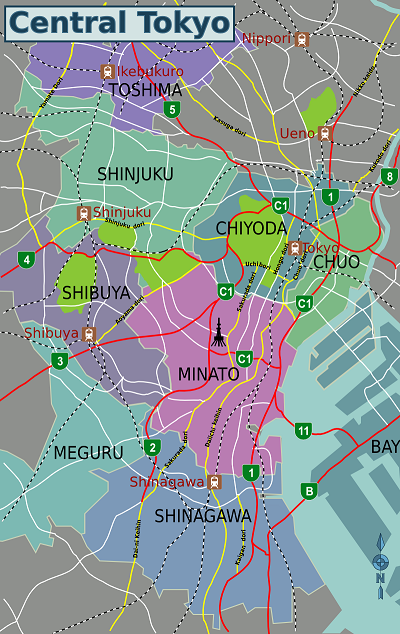

In [62]:
Image(filename='Central_Tokyo_map.png')

Central Tokyo is the commercial and financial center of Tokyo. It is home to famous districts like Shinjuku, Shibuya, Ikebukuro and Akihabara just to name a few.

Central Tokyo also contains three of the busiest train stations in the world: Shinjuku station, Shibuya station and Ikebukuro Station which makes locating an Airbnb listing in this area impactful for both guests and hosts alike.

**<u>Shinjuku</u>**

* **Cluster 2: Private Room Listings in Shinjuku**

  This cluster contains private rooms listings in Shinjuku. Among clusters that have private room listings (Clusters 1 to 4), this cluster has the:
  - highest average price
  - lowest average review score rating
  - highest availability

  The price highlights the importance of Shinjuku as one of the main commercial hubs in Tokyo. High availability could mean that bookings done in this cluster tend to be short-term bookings.  

* **Cluster 6: Entire Home/Apartment Listings in Shinjuku**
	
  This cluster contains entire home/apartment listings in Shinjuku. Among clusters that have entire home/apartments (Clusters 6 to 13), this cluster has the:
 - third highest average price
 - lowest average review score rating
 - highest average minimum nights required for booking

 Again, it is surprising to see low average scores for Shinjuku-based listings. This indicates that there are a lot more low-scoring listings in Shinjuku compared to other areas. It may be due in part to the presence of Kabukicho district, an entertainment and red-light district notorious for its Yakuza presence and tourist scams.

**<u>Shibuya</u>**

* **Cluster 10: Entire Home/Apartment Listings in Shibuya**

  This cluster contains entire home/apartment listings in Shibuya. Among the entire home/apartment clusters, this cluster has the:
 - second highest average price
 - highest average reviews per month

 Having also a high-traffic hub in Shibuya station, the high average price is no surprise. This cluster also contains the highest average reviews per month among all clusters which shows how popular listings located in this cluster are. With the proximity of widely popular attractions like Shibuya Crossing, the Hachiko statue, fashion-driven Harajuku district and scenic Omotesando, Shibuya may be the most ideal spot for guests aiming to get a quick taste of Tokyo.

**<u>Toshima</u>**

* **Cluster 9: Entire Home/Apartment Listings in Toshima**

  This cluster contains entire home/apartment listings in Toshima. Among the entire home/apartment clusters, this cluster has the:
 - fourth highest average price

 Again, the presence of a high-traffic hub in Ikebukuro Station explains the high average listing price. While there are no notable observations in terms of listing features for this cluster, Toshima is home to shopping establishments like the Seibu department store and Sunshine 60 shopping mall. It is also home to Tokyo's Chinatown which would be of particular interest to Chinese guests or guests wishing to eat Chinese food.

**<u>Chuo</u>**

* **Cluster 12: Entire Home/Apartment Listings in Chuo**

  This cluster contains entire home/apartment listings in Chuo. Among the entire home/apartment clusters, this cluster has the:
 - highest average price
 - lowest number of reviews per month
 - highest average availability

 Chuo is home to the Ginza district which is famous as one of the most luxurious, elegant and expensive districts in the world with its upscale shopping boutiques and luxury goods stores. Thus because of the area's luxury status, the listings in this cluster are the most expensive and least booked (as reflected in low reviews per month and high availability) across Tokyo.

**<u>Other Areas</u>**

* **Cluster 13: Entire Home/Apartment Listings across Tokyo**

  Although this cluster is comprised of entire home/apartment listings across Tokyo (other than the ones already included in the clusters mentioned above), the neighborhood with the most number of listings in this cluster is Minato, which is home to the Tokyo Tower and Roppongi district, an area whose nightlife scene is popular for locals and foreigners alike. This cluster contains Central Tokyo listings located in Chiyoda which is home to the world-famous Akihabara District.
   

**Figure 32. Old Tokyo**

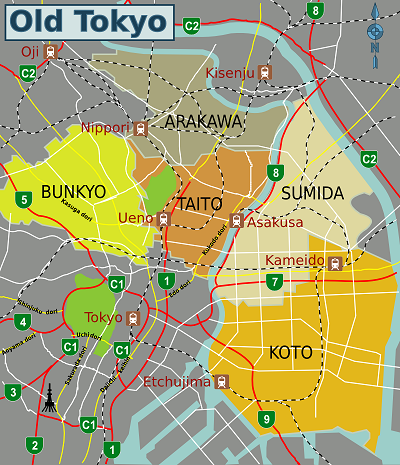

In [63]:
Image(filename='Shitamatchi_map.png')

The next major district is Old Tokyo which is home to many iconic sceneries associated with Japanese culture like the Sensoji temple and Ueno park with its sakura blossoms.

While Old Tokyo may be a bit far from the busy commercial areas of Central Tokyo, it is home to the scenic Asakusa district and Ueno park. Guests more in tuned with nature and traditional Japanse culture may prefer listings located in this area.

**<u>Taito</u>**

* **Cluster 1: Private Room Listings in Taito**

  This cluster contains private rooms listings in Taito. Among private rooms clusters, this cluster has the:
  - lowest average price
  - highest average number of people accommodated in a listing

  With its very low average price and spacious size (as interpreted from the accommodates number), this cluster has the most "bang-for-your-buck" listings.  

* **Cluster 7: Entire Home/Apartment Listings in Taito**
	
  This cluster contains entire home/apartment listings in Taito. Among the entire home/apartment clusters, this cluster has the:
 - second cheapest average price
 - thrid highest average reviews per month

 Again, we can see the lower price trend for listings in Taito. The listings in this cluster are also frequently booked as reflected in the average reviews per month. 
 
**<u>Sumida</u>**

* **Cluster 4: Private Room Listings in Sumida**

  This cluster contains private rooms listings in Sumida. Among private rooms clusters, this cluster has the:
  - second highest average price
  - highest average number of amenities
  - lowest availability
  - highest average reviews per month

  With the high number of amenities, listings in this cluster are more expensive than the average Old Tokyo private room listing. However, these listings are still popular as shown in the low availability and high number of reviews per month.  

* **Cluster 8: Entire Home/Apartment Listings in Sumida**
	
  This cluster contains entire home/apartment listings in Sumida. Among the entire home/apartment clusters, this cluster has the:
 - lowest average price
 - highest average reviews per month

 This cluster contains the cheapest entire home/apartment listings in Tokyo which would be of interest to families or groups looking to travel cheap. The high average reviews per month again reflects the popularity of listings located in Sumida.


**Figure 33. Outer Tokyo**

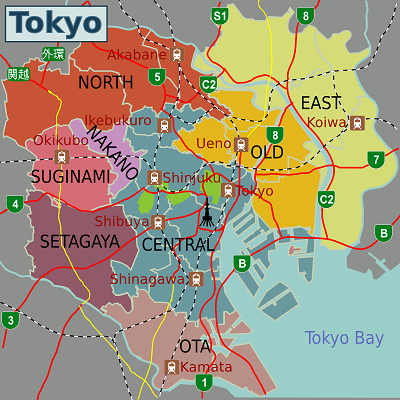

In [64]:
Image(filename='New_Tokyo_map.png')

Finally, we look at Outer Tokyo which comprise of the remaining wards/cities surrounding Central Tokyo and Old Tokyo. While Airbnb listings in this district are too scattered to be all clustered according to a unique neighborhood, a cluster of listings located in Ota was able to emerge.

**<u>Ota</u>**

* **Cluster 3: Private Room Listings in Ota**

  This cluster contains private rooms listings in Ota. Among private rooms clusters, this cluster has the:
  - second lowest average price
  - tied for highest average review score rating

  With its distance from Central Tokyo and Old Tokyo, listings in this cluster are much cheaper. However, it has very high ratings due to its close proximity to Haneda airport which is a very big point of convenience for travelers.  

* **Cluster 11: Entire Home/Apartment Listings in Ota**
	
  This cluster contains entire home/apartment listings in Ota. Among the entire home/apartment clusters, this cluster has the:
 - lowest availability
 - highest average review score rating

 Again, we can see the high review ratings due to the convenience given by the close proximity to Haneda airport. These listings as well are highly popular as reflected by the low availability. 
 
**<u>Other Clusters</u>**

* **Cluster 5: Shared Rooms/Hotel Rooms Across Tokyo**
	
  This cluster contains shared rooms/hotel rooms across Tokyo. Among all clusters, this cluster has the:
 - second lowest reviews per month
 - tied for lowest average review score rating

 Shared rooms/hotel rooms comprise only a very small percentage of listings in Tokyo. Its unpopularity can be reflected in the low average rating and low reviews per month.

#### **7.2 Summary of Findings**

The initial data exploration yielded a number interesting statistical trivia about Tokyo Airbnb listings, such as that all hosts have uploaded their profile pictures, that there are very few shared rooms being hosted on the platform, and that most review scores lie between 4.5 and 5.  There were numerous features in the dataset to consider however, and the initial EDA considered each feature in isolation, without yet providing a clear avenue for more detailed analysis.  Hence, dimensionality reduction using SVD and Agglomerative Clustering were highly useful tools in exploring the data further.

Clustering based on host service quality provided an alternative way of segmenting hosts, instead of the Superhost/non-Superhost classification. It showed how host experience is highly correlated with host behavior and service performance. There are experienced and superb hosts, and conversely inexperienced hosts who appear eager to respond, but have yet to bring their average review scores up. However, not all experienced hosts provide stellar service, as it can be seen that there is also a segment of experienced hosts who turn off the Instant Booking feature, and they tend to be more moderate in their service quality. Finally, there is a segment of hosts that are perhaps best avoided, as they perform poorly on nearly all criteria. Incorporating this clustering into Airbnb's recommender engine may help guests make informed decisions on where to say, or allow Airbnb to provide more targeted guidance to hosts on how they might improve their performance or better incentivize guests to book their properties and leave good reviews. This information may also provide Airbnb with useful information on which hosts to penalize or deactivate from the platform.

On convenience and accessibility, 3 clusters were formed, segmenting the listings into 3 major areas in Tokyo - Nearest Haneda International Airport, Central & Westernmost, and Northern Block. Among the clusters, the Central & Westernmost cluster seem to have the best location and check-in scores. This cluster covers major tourist spots around Tokyo such as Shinjuku, Shibuya, and Minato. It also houses Tokyo Train Station, making it highly accessible to locals and tourists from all over Japan. This suggests that Airbnb travelers in Tokyo make booking and rating distinctions based on airport convenience, city center proximity and tourist convenience, and all the rest. This may be similarly useful for Airbnb's recommender systems.

Finally, clustering was performed on selected key features, to provide a top-level view of different types of Airbnb experiences. Knowledge of these clusters can help a traveler make informed decisions on where to stay based on the specific experience they are looking for. A recommender engine that factors in multiple criteria, including a guest's budget, areas of interest, preferred accommodation, and service priorities, will all benefit from this segmentation of what Tokyo Airbnb listings have to offer. Also, knowing what cluster a listing might belong to could help them to be more competitive in that space, to make their listings more attractive and earn better scores relative to their counterparts.

### **8 Conclusion and Recommendations**

As a data exploration study, clustering allows for a deeper level of insight that would not have been possible with only basic distribution and count plots. Understanding the different segements or categories of listings based on host behavior and service, location and check-in convenience, and overall features can help Airbnb and hosts alike make better strategies to position themselves based on their objectives.

For instance, for the host service clusters:
- **Cluster 1** hosts appear already knowledgeable and incentivized to providing guests with a good experience, so Airbnb only needs to ensure that these hosts remain happy with the platform. They might also want to direct guests to these listings as they contribute to Airbnb's brand image. 
- **Cluster 2** hosts are inexperienced, so Airbnb may want to focus on providing them with better guidance and encouragement to stay the course and improve performance. Airbnb and the hosts themselves may wanto to consider offering discounts, to help bring their booking and review numbers (and ratings) up, to gain experience and better scores.
- **Cluster 3** hosts appear more concerned with guest screening, as they turn off the Instant Booking feature, hence they essentially operate under a different business model. Since guests are scored on the platform as well by their previous hosts, Airbnb may want to consider directing  highly rated guests to these Cluster 3 hosts, to minimize possible issue and minimize the need for hosts to reject guest inquiries.
- **Cluster 4** may be putting the brand iage of Airbnb at risk. Airbnb may want to review these hosts if they are indeed still active, and consider incentives that might get them to improve their level of service, or otherwise disincentivize guests from booking their properties.

For the convenience clusters, these represent different segments of what customers may be looking for:
- **Cluster 1** represents listings near Haneda Airport. Airbnb may want to recommend these to business travelers, or guests flying in from abroad, with very short-duration stays.
- **Cluster 2** represents listings in the city center and western districts, nearer the most popular tourist attractions. Airbnb may want to recommend these to the most touristy custoemr segments, or those traveling into Tokyo by train, via Shinjuku Station.
- **Cluster 3** represents listings in a more northern area of Tokyo, which are farther from the city center, but nonetheless have cultural and shopping attractions in Akihabara, Asakusa, and Ikebukuro. Airbnb and hosts may want to incentivize guests to these areas with discounts, or experiences tailored to promote the nearby points of interest.

For the overall experience clusters, the details are outlined in the previous section, and may be rather too many to list here. Aside from incorporating this clustering into Airbnb's recommender engine to help match customer segments with travel experiences, we can list a few useful, actionable insights:
- **Cluster 6**, despite being located in the very popular Shinjuku district, have low average ratings. This is an opprtunity for the hosts to improve and identify strategies to counteract (or capitalize on) possible unsavory elements in Shinjuku's red light and entertainment district.
- **Clusters 2** has high prices, and yet, high availability as well. There may be an opportunity for some hosts to lower their prices and increase their occupancy rates, thus maximizing revenues (for themselves and Airbnb). **Cluster 12** is similar to Cluster 2 in having high prices. However, they are also the least-booked and least-reviewed cluster, so there may be opportunity for them to maximize revenues through price competition as well. However this strategy should be undertaken carefully since this is a luxury district.
- **Cluster 1 and 7** contains listings in Taito to recommend for the most budget-conscious travelers, consisting of private rooms accommodating large number of people. This would be recommended for young travelers and backpackers.
- **Cluster 4** in Sumida may be suitable for hosts with spare rooms they may want to invest in, by converting them into an Airbnb property. These listings command high prices and yet are in demand, as reflected with low availability.

Based on these initial findings, the study analysts would like to propose potential avenues of further research, to drill down for deeper insights and patterns among the identified significant features, or widen the scope further, possibly involving other datasets.  Some questions that future studies may address include:

- What are other feature sets might yield insight upon clustering? What would clusters look like if performed based on, say, luxury of accommodations (based on price and property size), number and type of amenities, or combinations of these?
- How do Airbnb reviews, prices, and frequency of reservations compare before and after the onset of the COVID-19 pandemic?
- How do Airbnb listing patterns in Tokyo compare to those in other major cities around the world, whether in neighbors around East Asia or in more far-off countries?
- Proximity to nearest transportation hubs (airport, train/bus station, etc.) might also be worth looking into in studying AirBnb listings. This may shed more light on the convenience/accessibility aspect of the listings.

### **9 References**

[1] Inside Airbnb, "About Inside Airbnb" Retrieved from http://insideairbnb.com/about.html

[2] Business Insider, "How 3 guys turned renting air mattresses in their apartment into a $31 billion company, Airbnb" Retrieved from https://www.businessinsider.com/how-airbnb-was-founded-a-visual-history-2016-2

[3] Airbnb Help Center, "How do I become a Superhost?" Retrieved from https://www.airbnb.com/help/article/829/how-do-i-become-a-superhost

[4] Live Japan Perfect Guide, "12 Unique Tokyo Neighborhoods & Districts You’ll Want to Wander Around!" Retrieved from https://livejapan.com/en/article-a0002322/

[5] Wikipedia, "Tokyo" Retrieved from https://wikitravel.org/en/Tokyo

### **10 Acknowledgements**

We would like to acknowledge:

- Prof. Christian Alis, for challenging his students to learn about the concepts and skills related to data mining, especially dimensionality reduction and clustering
- Prof. Christopher Monterola, for providing students with a view on how data mining skills are useful and necessary for machine learning
- Leo Lorenzo II, for being a responsive mentor who is consistently enthusiastic in responding to questions and providing advice